In [3]:
#importing all libraries

import torch
from torch import nn, optim
import torch.nn.functional as F

import torch.optim as optim

import torchvision.utils as vutils
from torchvision import datasets, transforms
from torchvision.utils import save_image
import os
import matplotlib.pyplot as plt
import numpy as np
from torch.utils.data import Dataset, DataLoader
from PIL import Image

import random

/home/hb/.local/lib/python3.10/site-packages/matplotlib/projections/__init__.py:63: UserWarning: Unable to import Axes3D. This may be due to multiple versions of Matplotlib being installed (e.g. as a system package and as a pip package). As a result, the 3D projection is not available.
  warnings.warn("Unable to import Axes3D. This may be due to multiple versions of "


## Question 1

q1. Train a DC GAN (with an architecture of your choice) on the given data
with the usual GAN loss. Plot the loss curves for the Generator and
Discriminator losses.

In [4]:
# Root directory for dataset
dataroot_butterfly = "/home/hb/Documents/adrl_assignment/assignment1/train"
dataroot_animals = "/home/hb/Documents/adrl_assignment/assignment1/animals"

# Decide which device we want to run on
device = torch.device("cuda:0" if torch.cuda.is_available()  else "cpu")

# Batch size during training
batch_size = 64

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 128

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 128

# Size of feature maps in discriminator
ndf = 128
# Number of training epochs we have vary this based on experiment we did
num_epochs = 20

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparameter for Adam optimizers
beta1 = 0.5


In [173]:
# data augumentation resizing to 160 first and then cropping to 128 this will prevent the black boarfder in the image
# when we do affine transformation and rotatiion and then center crop the image

augmentation_transforms = transforms.Compose([
    # Resize to a larger size first (e.g., 160x160 if the original is 128x128) we do this because when we 
    # rotate the image  it should not have black border
    transforms.Resize(160),
    # transforms.RandomRotation(degrees=10),  # Randomly rotate the image
    transforms.RandomAffine(degrees = 0, translate=(0.1, 0.1), scale=(0.8, 1.2)),  # Random affine transformations
    transforms.CenterCrop((128, 128)),  # Crop it back to 128x128
    # transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.2),  # Color jittering
])

def augment_and_save_images(dataroot, target_image_count=600, image_format='.jpg'):
    for folder in os.listdir(dataroot):
        folder_path = os.path.join(dataroot, folder)
        
        if os.path.isdir(folder_path): 
            images = os.listdir(folder_path)
            image_count = len(images)
            image_suffix = image_format if image_format.startswith('.') else f".{image_format}"

            if image_count >= target_image_count:
                continue
            num_to_generate = target_image_count - image_count

            print(f"Generating {num_to_generate} images for folder: {folder}")

            for i in range(num_to_generate):
                img_name = random.choice(images)
                img_path = os.path.join(folder_path, img_name)
                
                with Image.open(img_path) as img:
                    img = img.convert('RGB')  # Ensure it's in RGB format
                    augmented_img = augmentation_transforms(img)
                    new_img_name = f"{img_name.split('.')[0]}_augmented_{i+1}{image_suffix}"
                    new_img_path = os.path.join(folder_path, new_img_name)

                    augmented_img.save(new_img_path)
                    print(f"Saved augmented image: {new_img_path}")

# generating 600 images per class
target_image_count = 600  

# Run the augmentation process
augment_and_save_images(dataroot=dataroot_animals, target_image_count=target_image_count)

6499
torch.Size([3, 128, 128])


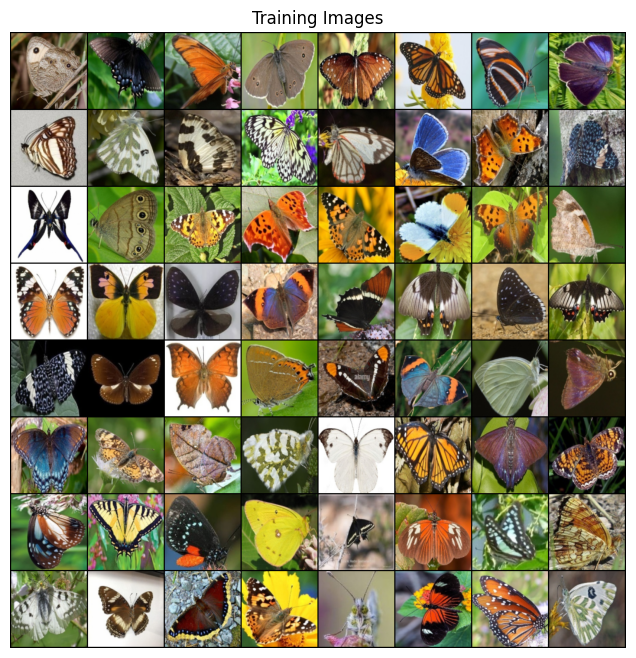

In [84]:
# We can use an image folder dataset the way we have it setup.
# Create the dataset

class CustomDataset_butterfly(Dataset):
    def __init__(self, data_root, transform=None):
        self.data_root = data_root
        self.transform = transform
        self.images = [img for img in os.listdir(data_root) if img.endswith(('jpg', 'png'))]
        print(len(self.images))

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        img_path = os.path.join(self.data_root, self.images[idx])
        image = Image.open(img_path).convert('RGB')
        if self.transform:
            image = self.transform(image)
        return image

dataset_butt = CustomDataset_butterfly(data_root=dataroot_butterfly,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
butt_dataloader = DataLoader(dataset_butt, batch_size=batch_size,shuffle=True)

# Plot some training images
real_batch = next(iter(butt_dataloader))
print(real_batch[0].shape)
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch, padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()

In [6]:
# custom weights initialization called on ``netG`` and ``netD``
def weights_init(m):
    classname = m.__class__.__name__
    
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)
    elif classname.find('Linear') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
        nn.init.constant_(m.bias.data, 0)
    elif classname.find('Embedding') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    # For InstanceNorm2d layers
    elif classname.find('InstanceNorm2d') != -1:
        if m.affine:
            nn.init.normal_(m.weight.data, 1.0, 0.02)  # Initialize weights to 1 with some noise
            nn.init.constant_(m.bias.data, 0)  # Initialize bias to 0

In [7]:
#generator and discriminator

class Generator_dcgan(nn.Module):
    def __init__(self):
        super(Generator_dcgan, self).__init__()
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d(     nz, ngf * 16, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 16),
            nn.ReLU(True),
            # state size. (ngf*16) x 4 x 4
            nn.ConvTranspose2d(ngf * 16, ngf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 8 x 8
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 16 x 16 
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 32 x 32
            nn.ConvTranspose2d(ngf * 2,     ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 64 x 64
            nn.ConvTranspose2d(    ngf,      nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 128 x 128
        )

    def forward(self, input):
        return self.main(input)
    
class Discriminator_dcgan(nn.Module):
    def __init__(self):
        super(Discriminator_dcgan, self).__init__()
        self.main = nn.Sequential(
            # input is (nc) x 128 x 128
            nn.Conv2d(nc, ndf, 4, stride=2, padding=1, bias=False), 
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 64 x 64
            nn.Conv2d(ndf, ndf * 2, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 32 x 32
            nn.Conv2d(ndf * 2, ndf * 4, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 16 x 16 
            nn.Conv2d(ndf * 4, ndf * 8, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 8 x 8
            nn.Conv2d(ndf * 8, ndf * 16, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(ndf * 16),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*16) x 4 x 4
            nn.Conv2d(ndf * 16, 1, 4, stride=1, padding=0, bias=False),
            nn.Sigmoid()
            # state size. 1
        )

    def forward(self, input):
        return self.main(input)

In [76]:
# Initialize the ``BCELoss`` function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 0.9
fake_label = 0.1

# model generator amd discriminator
netG = Generator_dcgan().to(device)
netG.apply(weights_init)

# Create the Discriminator
netD = Discriminator_dcgan().to(device)
netD.apply(weights_init)

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [174]:
# Training Loop dcgan BUTTERFLY

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0
k = 2
num_epochs = 100

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    for i, data in enumerate(butt_dataloader, 0):
        # training the discriminator k times
        for _ in range(k):
            netD.zero_grad()
            real_image = data.to(device)
            batch_size = real_image.size(0)
            label = torch.full((batch_size,), real_label, dtype=torch.float, device=device)
            # print("label shape  ", label.shape)
            # Forward pass real batch through D
            output_real = netD(real_image).view(-1)
            # print("output shape  ", output.shape)
                        
            errD_real = criterion(output_real, label)
            errD_real.backward()
            D_x = output_real.mean().item()
            noise = torch.randn(batch_size, nz, 1, 1, device=device)
            fake_image = netG(noise)
            label.fill_(fake_label)
            output_fake = netD(fake_image.detach()).view(-1)
            errD_fake = criterion(output_fake, label)
            errD_fake.backward()
            D_G_z1 = output_fake.mean().item()
            errD = errD_real + errD_fake
            optimizerD.step()

        
        #train the desicriminator
        netG.zero_grad()
        label.fill_(real_label) 
        output_fake = netD(fake_image).view(-1)
        errG = criterion(output_fake, label)
        errG.backward()
        D_G_z2 = output_fake.mean().item()
        optimizerG.step()

        # Output training stats
        if i % 300 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dcgan_dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dcgan_dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

            plt.figure(figsize=(8, 8))
            plt.axis("off")
            plt.title("Generated Images")
            plt.imshow(np.transpose(vutils.make_grid(fake, padding=2, normalize=True), (1, 2, 0)))
            plt.show() 

        iters += 1


# save the generator model
torch.save(netG.state_dict(), 'final/dcgan_gen_butter.pth')
# save the discriminator model
torch.save(netD.state_dict(), 'final/dcgan_des_butter.pth')

## QUN2. plot of buttterfly images generated from dc gan

2. Plot a 10 by 10 grid of images for generated images.


/tmp/ipykernel_1726230/2000246171.py:4: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  netG_trained.load_state_dict(torch.load('final/generator/dcgan_gen_butter.pth'))


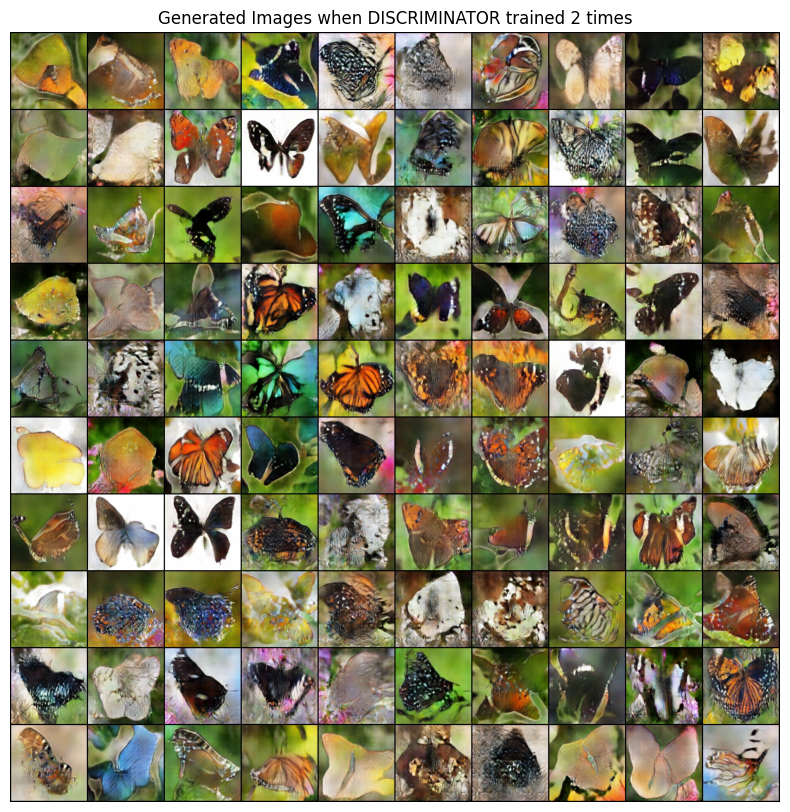

In [175]:
#qun2  plot generated images on 10*10 grid
#load trained model
netG_trained = Generator_dcgan().to(device)
netG_trained.load_state_dict(torch.load('final/generator/dcgan_gen_butter.pth'))

fixed_noise_gen = torch.randn(100, nz, 1, 1, device=device)
with torch.no_grad():
    fake = netG_trained(fixed_noise_gen).detach().cpu()
    img_list.append(vutils.make_grid(fake, nrow=10, padding=2, normalize=True))

    plt.figure(figsize=(10, 10))
    plt.axis("off")
    plt.title("Generated Images when DISCRIMINATOR trained 2 times")   
    plt.imshow(np.transpose(img_list[-1], (1, 2, 0)))
    plt.show()

dc gan image generation.

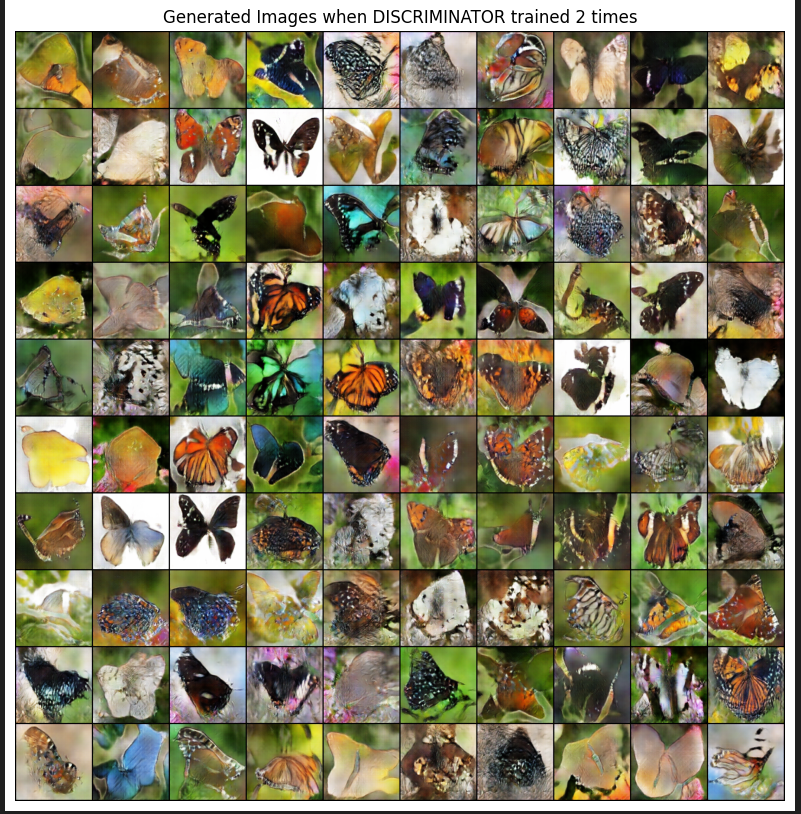


## QUN3 PLOT OF LOSS OF GENERATOR AND DISCRIMINATOR

Vary the number of times the generator and discriminator is trained and
document the outcome.

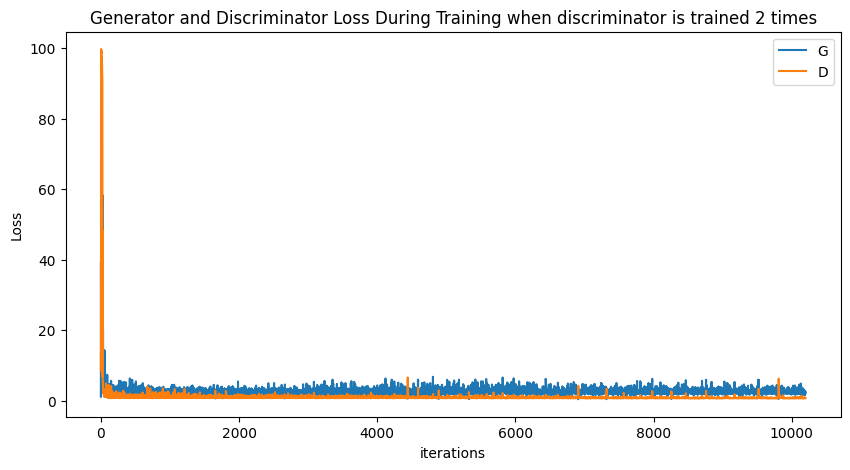

In [48]:
#qun 3 plot loss of generator and discriminator
#plotting the loss function
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training when discriminator is trained 2 times")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

loss of dc gan generator and discriminator
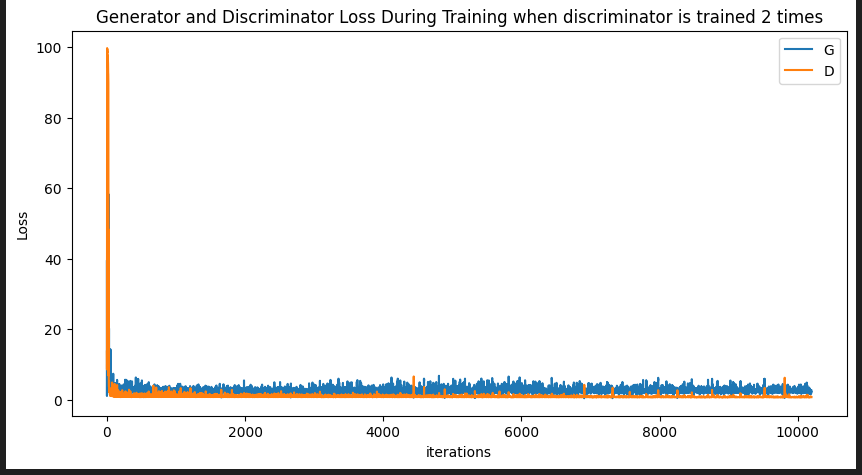

## QUN4 FID SCORE CALCULATION. CALCULATED THE  FID SCORE OF BUTTERFLY IMAGES GENERATD USING THE DCGAN

Write a code for computing the FID and compute FID by sampling 1000
data-points from both the true and the generated data distributions.

In [63]:
#qun4 to calculate the fid score

import numpy as np
from scipy.linalg import sqrtm
import torch
from torchvision import models
from scipy.linalg import sqrtm


def calculate_statistics(features):
    features_np = features.cpu().numpy()
    mu = np.mean(features_np, axis=0)
    sigma = np.cov(features_np, rowvar=False) + np.eye(features_np.shape[1]) * 1e-6
    return mu, sigma
 
def calculate_fid(real_images, fake_images, device='cpu'):
    inception = models.inception_v3(pretrained=True, transform_input=False).to(device)
    inception.eval()
 
    with torch.no_grad():
        real_features = inception(real_images).detach()
        fake_features = inception(fake_images).detach()
 
    mu_real, sigma_real = calculate_statistics(real_features)
    mu_fake, sigma_fake = calculate_statistics(fake_features)
 
    diff = mu_real - mu_fake
    sqrt_sigma_real = sqrtm(sigma_real)
    if np.iscomplexobj(sqrt_sigma_real):
        sqrt_sigma_real = sqrt_sigma_real.real
 
    term0 = sqrt_sigma_real @ sigma_fake
    term = sqrtm(term0 @ sqrt_sigma_real)
    if np.iscomplexobj(term):
        term = term.real
 
    fid = np.sum(diff**2) + np.trace(sigma_real + sigma_fake - 2 * term)
    return fid**0.5

In [93]:
#4.1 calculating fid score for dc-gan

image_batch = 1000

real_batch = []
for batch in butt_dataloader:
    images= batch  
    real_batch.append(images)
    if len(real_batch) * images.size(0) >= image_batch:
        break

real_images = torch.cat(real_batch)[:image_batch]

# Generate fake images using the generator model
latent_dim = 100
netG = Generator_dcgan()
netG.load_state_dict(torch.load('final/dcgan_gen_butter.pth'))
latent_vector = torch.randn(1000, latent_dim, 1, 1)
fake_images = netG(latent_vector).detach()

fid_score = calculate_fid(real_images, fake_images)
print(f"FID Score: {fid_score}")

/tmp/ipykernel_1726230/624992508.py:17: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  netG.load_state_dict(torch.load('final/dcgan_gen_butter.pth'))
/home/hb/.local/lib/pyth

FID Score: 72.01785660483979


GET FID SCORE OF 72.5 WHEN TRAINED DCGAN ON BUTTERFLY DATASET.

## QUN5. LATENT SPACE TRAVERSAL.

Implement two types of latent space traversals and plot the outcomes.
Latent space traversal refers to randomly sampling two input vectors and
generating images via (Linear or non-linear) interpolations

In [170]:
# WE HAVE TO DO LATENT SPACE TRAVERSAL 
# TO GENERATE THE IMAGES WE NEED LATENT VECTOR AND WE WANT TO GENERATE THIS LATENT VECTOR USING 
# LINEAR INTERPOLATION BETWEEN TWO LATENT VECTORS
# AND THEN PASS THAT LATENT VECTOR TO GENERATOR TO GENERATE THE IMAGES

import torch 
from matplotlib import pyplot as plt 
from torchvision.utils import make_grid

def get_latent(latent0, latent1, interpolation='linear'): 
    if interpolation == 'linear': 
        epsilon = torch.arange(100, device=latent0.device)/100
    elif interpolation == 'non-linear': 
        epsilon = torch.sin(torch.arange(100, device=latent0.device)/100 * np.pi/2)
    else:
        raise ValueError('Interpolation must be either linear or non-linear')
    epsilon = epsilon.view(-1, 1, 1, 1)
    print("epsilon shape  ",epsilon.shape)
    return (1-epsilon) * latent0 + latent1 * epsilon

def traversal(latent_dim, interpolation='linear'):
    latent0 = torch.randn(1, latent_dim, 1, 1, device=device)
    latent1 = torch.randn(1, latent_dim, 1, 1, device=device)
    lat = get_latent(latent0, latent1, interpolation)

    img_list = []
    with torch.no_grad():
        fake = netG_trained(lat).detach().cpu()
        img_list.append(vutils.make_grid(fake, nrow=10, padding=2, normalize=True))

        plt.figure(figsize=(10, 10))
        plt.axis("off")
        plt.title(f"Generated Images during Latent {interpolation} Traversal")
        plt.imshow(np.transpose(img_list[-1], (1, 2, 0)))
        plt.show()

epsilon shape   torch.Size([100, 1, 1, 1])


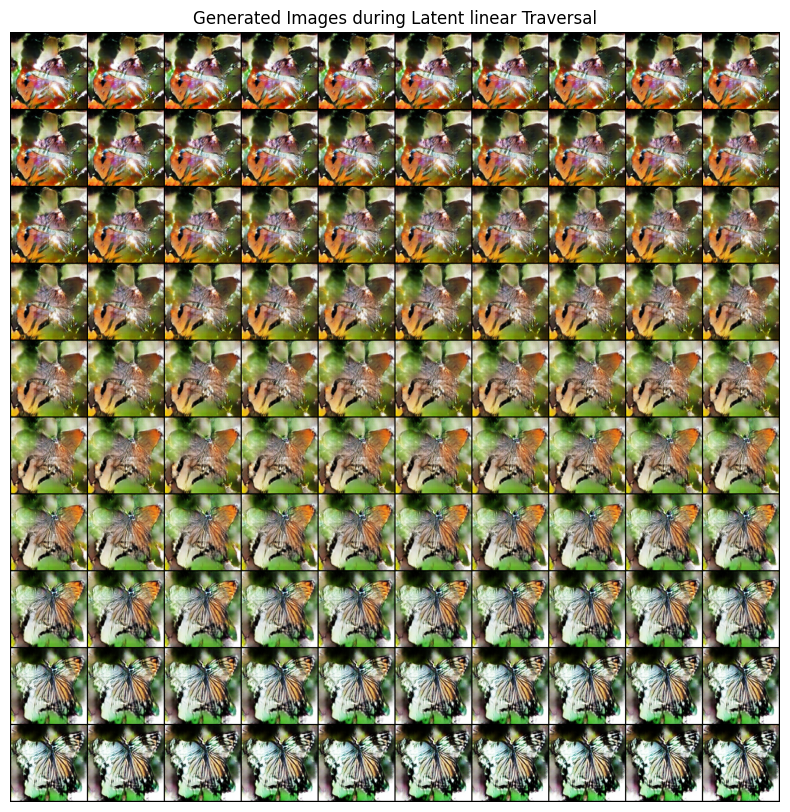

epsilon shape   torch.Size([100, 1, 1, 1])


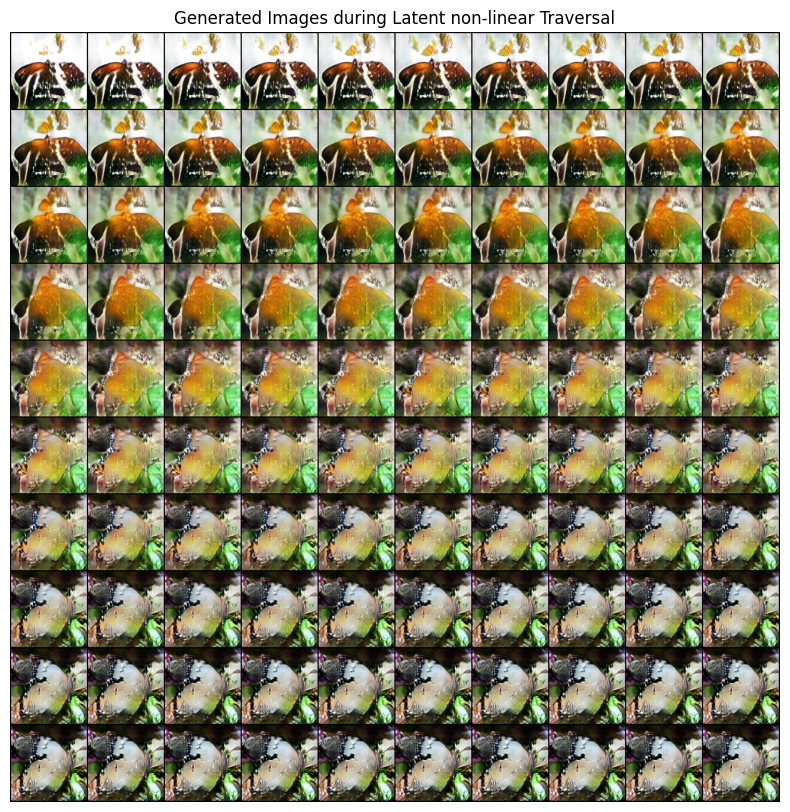

In [171]:
#calling traversal  function
# netG_trained = Generator_dcgan().to(device)
# netG_trained.load_state_dict(torch.load('final/generator/dcgan_gen_butter.pth'))
#below is linear interpolation traversal

traversal(latent_dim, 'linear')
#below is non-linear interpolation traversal
traversal(latent_dim, 'non-linear')

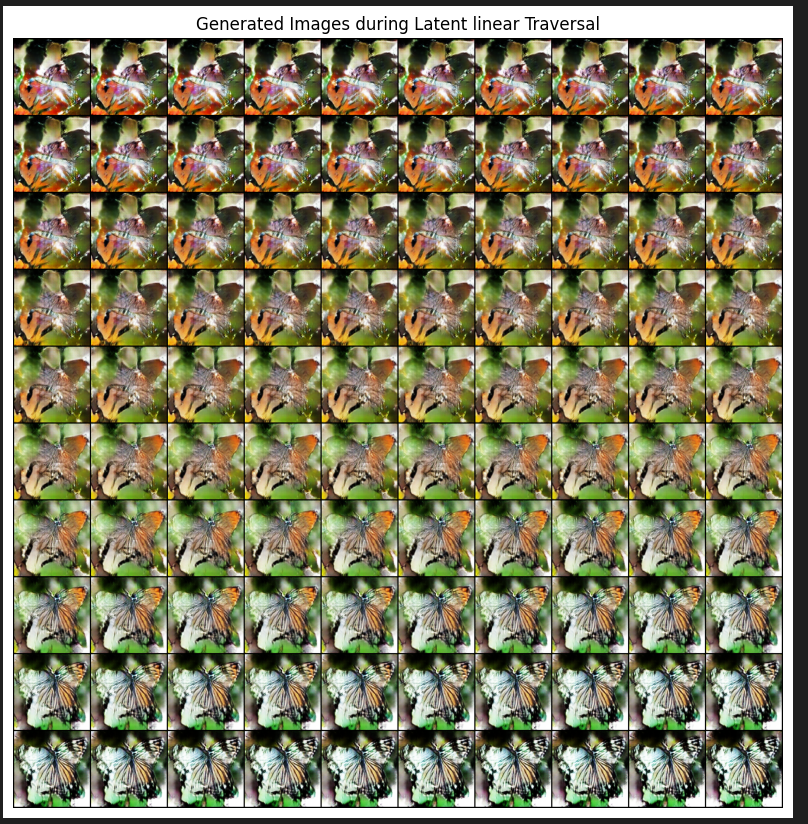

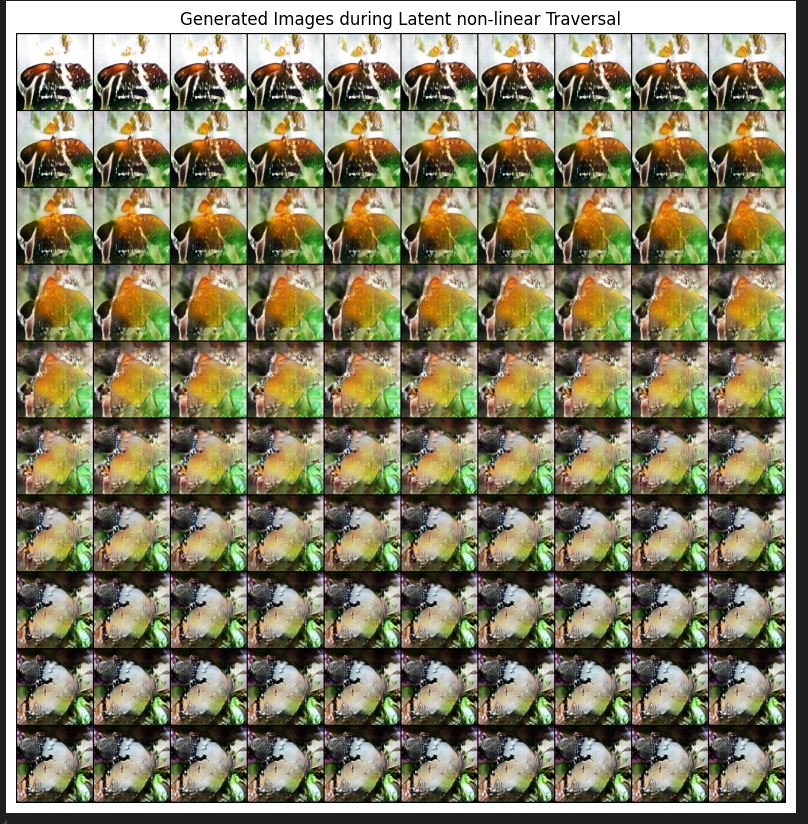

## QUN6. CONDITIONAL GAN'S. 

Implement conditional generation by randomly choosing 20 subclasses in
the data.

{0: 'bee', 1: 'caterpillar', 2: 'rat', 3: 'ox', 4: 'hummingbird', 5: 'crab', 6: 'cockroach', 7: 'fox', 8: 'okapi', 9: 'cow', 10: 'hornbill', 11: 'donkey', 12: 'hare', 13: 'rhinoceros', 14: 'gorilla', 15: 'owl', 16: 'bat', 17: 'grasshopper', 18: 'hedgehog', 19: 'lion'}
tensor([13,  4,  6, 10,  3,  4,  6, 16, 16,  3,  4, 10, 11, 17, 10, 17,  7,  0,
         1, 19, 15,  7, 10, 10,  6, 17,  7, 12,  7,  5,  3,  0,  5, 12,  4,  6,
        17, 10, 12,  8,  5, 13,  8,  7, 17, 13,  0,  9, 11, 10, 10, 17, 12, 19,
         9,  7,  4, 11,  8,  7, 15, 13, 10, 16])
64


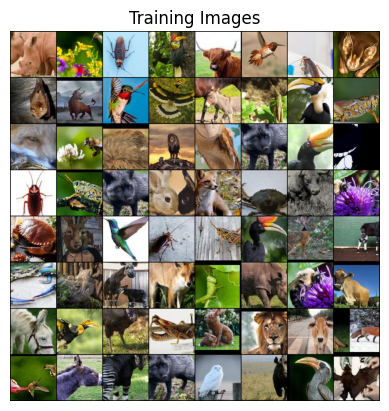

In [94]:
#qun traind conditional gan on animals dataset
#picked 20 classes from dataset and trained the conditional generator model
#data loading cgan
#cgan parameters
num_classes = 20
# embedding dimension
embed_size = 40.

class CustomDataset_conditional_Gan(Dataset):
    def __init__(self, dataroot, num_classes = 20, transform=None):
        self.data_root = dataroot
        self.transform = transform
        self.images = []
        self.animal_dict = {}

        idx = 0
        for folder in os.listdir(dataroot):
            for img in os.listdir(os.path.join(dataroot, folder)):
                if img.endswith(('jpg', 'png')):
                   self.images.append([os.path.join( folder, img),idx])
            
            self.animal_dict[idx] = folder            
            idx += 1 
            if idx == num_classes:
                 break
    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        img_path = os.path.join(self.data_root, self.images[idx][0])
        img_class = self.images[idx][1]

        image = Image.open(img_path).convert('RGB')
        if self.transform:
            image = self.transform(image)
        return [image, img_class]
    
    def get_class_name(self, idx):
        return self.animal_dict[idx]
    
    def get_animal_dict(self):
        return self.animal_dict

dataset_cgan = CustomDataset_conditional_Gan(dataroot=dataroot_animals,num_classes=num_classes,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader

animal_dict = dataset_cgan.get_animal_dict()
print(animal_dict)
dataloader_cgan = torch.utils.data.DataLoader(dataset_cgan, batch_size=batch_size, shuffle=True, drop_last=True)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available()) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader_cgan))
print(real_batch[1])
print(len(real_batch[1]))
# plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()

In [99]:
#conditional generator and conditional discriminator defination

class Gencgan(nn.Module):
    def __init__(self,num_classes, embed_size):
        super(Gencgan, self).__init__()
        self.num_classes = num_classes
        self.embed_size = embed_size

        self.class_embeddings = nn.Embedding(num_classes, embed_size)
        self.main = nn.Sequential(
            # input is Z, going into a convolution

            nn.ConvTranspose2d( nz+embed_size, ngf * 16, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 16),
            nn.ReLU(True),
            # state size. (ngf*16) x 4 x 4
            nn.ConvTranspose2d(ngf * 16, ngf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 8 x 8
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 16 x 16 
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 32 x 32
            nn.ConvTranspose2d(ngf * 2,     ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 64 x 64
            nn.ConvTranspose2d(    ngf,      nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 128 x 128
        )

    def forward(self, input, labels):
        # label is the integer value corresponds to index  #shape is batch_size 
        class_embed = self.class_embeddings(labels)  # shape  is batch_size x embed_size
        batch_size = input.size(0)
        class_embed = class_embed.view(batch_size, self.embed_size, 1, 1)  # shape is batch_size x embed_size x 1 x 1

        input = torch.cat([input, class_embed], 1) # shape is batch_size x (noise dim + num_classes) x 1 x 1
        return self.main(input)
    

class Disccgan(nn.Module):
    def __init__(self, image_size, num_classes):
        super(Disccgan, self).__init__()
        self.image_size = image_size
        self.class_embeddings = nn.Embedding(num_classes, image_size*image_size)
        self.main = nn.Sequential(
            # input is (nc) x 128 x 128
            nn.Conv2d(nc + 1, ndf, 4, stride=2, padding=1, bias=False), 
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 64 x 64
            nn.Conv2d(ndf, ndf * 2, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 32 x 32
            nn.Conv2d(ndf * 2, ndf * 4, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 16 x 16 
            nn.Conv2d(ndf * 4, ndf * 8, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 8 x 8
            nn.Conv2d(ndf * 8, ndf * 16, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(ndf * 16),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*16) x 4 x 4
            # print("last layer input ",ndf * 16),
            nn.Conv2d(ndf * 16, 1, 4, stride=1, padding=0, bias=False),
            nn.Sigmoid()
            # state size. 1
        )
      

    def forward(self, input, labels):
        #input is of shape batch_size x nc x 128 x 128
        # labels has size = batch_size
        embed = self.class_embeddings(labels) #shape of embed is batch_size * image_size * image_size
        # to add with the input image, we need to reshape the embed to batch_size x 1 x image_size x image_size
        embed = embed.view(batch_size, 1, self.image_size, self.image_size)
        # now we will conjcatenate the input image with label embedding along the dimension 1
        input = torch.cat([input, embed], 1)   # shape of input is batch_size x (nc+1) x 128 x 128
        # print("x shape    ",x.shape)
        return self.main(input)
    


In [101]:
#cgan model creation and parameter initialization
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 0.95
fake_label = 0.05
embed_size = 100

gen_cgan = Gencgan(num_classes,embed_size).to(device)
gen_cgan.apply(weights_init)

# Create the Discriminator
disc_cgan = Disccgan(image_size, num_classes).to(device)
disc_cgan.apply(weights_init)
# Setup Adam optimizers for both Generator and Discriminator
optimizerD = optim.Adam(disc_cgan.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(disc_cgan.parameters(), lr=lr, betas=(beta1, 0.999))

In [176]:
# Training Loop
img_list = []
G_losses = []
D_losses = []
iters = 0
k = 2
num_epochs = 50

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
   
    for i, data in enumerate(dataloader_cgan, 0):
        # training the discriminator k times
        for _ in range(k):
            disc_cgan.zero_grad()
            # Format batch
            real_image = data[0].to(device)
            true_labels = data[1].to(device)
            b_size = real_image.size(0)
    
            label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
            # print("label shape for disc real  ", label.shape)
          
            output = disc_cgan(real_image, true_labels).view(-1)            
            errD_real = criterion(output, label)
            errD_real.backward()
            D_x = output.mean().item()  

            noise = torch.randn(b_size, nz, 1, 1, device=device)  
            # Generate fake image batch with G
            fake_image = gen_cgan(noise, true_labels )
            label.fill_(fake_label)
            output = disc_cgan(fake_image.detach(), true_labels).view(-1)
            errD_fake = criterion(output, label)
            
            # Calculate the gradients for this batch, accumulated (summed) with previous gradients
            errD_fake.backward()
            D_G_z1 = output.mean().item()
            # Compute error of D as sum over the fake and the real batches
            errD = errD_real + errD_fake
            # Update D
            optimizerD.step()

        #train generator 
        gen_cgan.zero_grad()
        label.fill_(real_label)  
        output = disc_cgan(fake_image, true_labels).view(-1)
        errG = criterion(output, label)
        errG.backward()
        D_G_z2 = output.mean().item()
        optimizerG.step()

        # Output training stats
        if i % 150 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader_cgan),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 250 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader_cgan)-1)):
            with torch.no_grad():
                fake = gen_cgan(fixed_noise,true_labels).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

            plt.figure(figsize=(8, 8))
            plt.axis("off")
            plt.title("Generated Images")
            plt.imshow(np.transpose(vutils.make_grid(fake, padding=2, normalize=True), (1, 2, 0)))
            plt.show() 

        iters += 1

# save the generator model
torch.save(gen_cgan.state_dict(), 'final/generator/con_gen_20class.pth')
# save the discriminator model
torch.save(gen_cgan.state_dict(), 'final/generator/con_gen_20class.pth') 

trained this model  on other file and loaded here

/tmp/ipykernel_1726230/1705472658.py:4: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  Cgan_trained.load_state_dict(torch.load('final/generator/con_gen_20class.pth'))


torch.Size([100])
<class 'torch.Tensor'>


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99105644..0.9161707].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9764306..0.9546515].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9912632].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99660695].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8777261].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999979..0.94920266].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99927473..0.9985781].

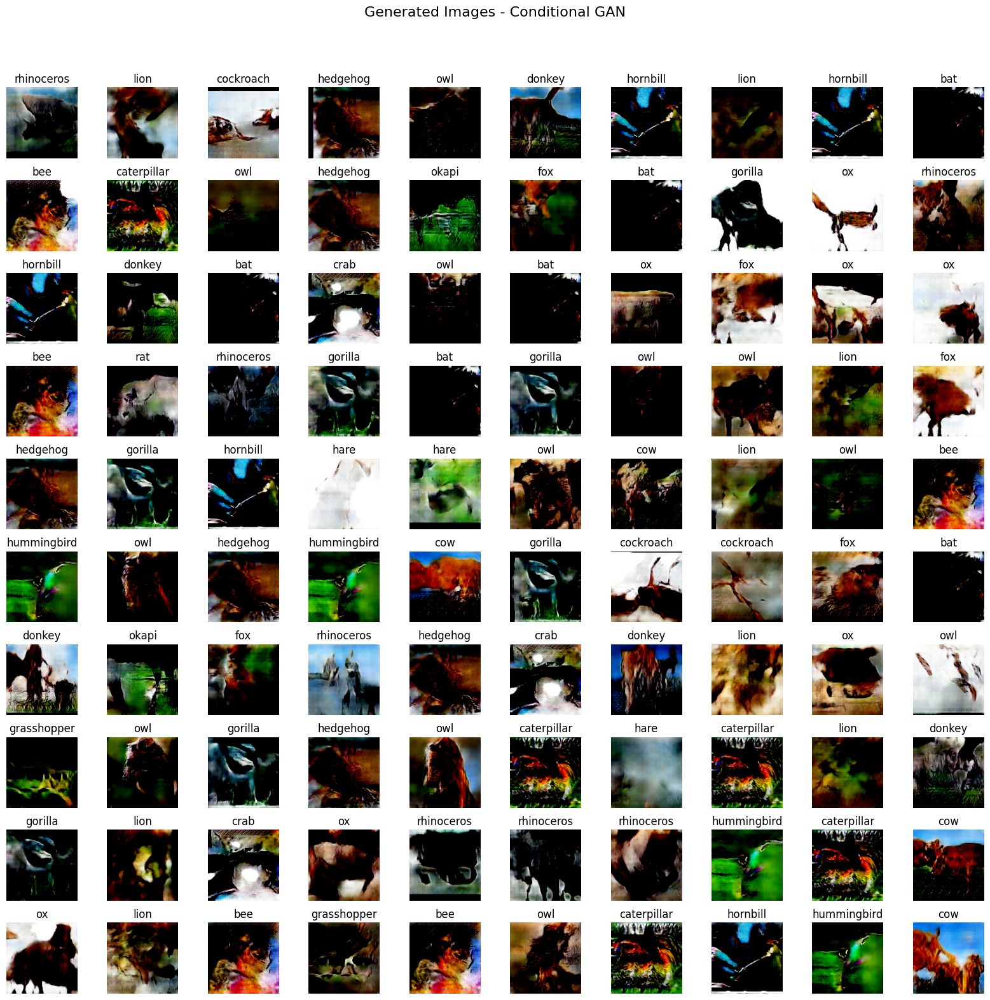

In [106]:
#plot generated images on 10*10 grid
#load trained model
Cgan_trained = Gencgan(num_classes, embed_size).to(device)
Cgan_trained.load_state_dict(torch.load('final/generator/con_gen_20class.pth'))

img_labels = []
for i in range(2):
    real_img_batch = next(iter(dataloader_cgan))
    img_labels += real_img_batch[1].to(device)

img_labels = torch.tensor(img_labels[:100]).to(device)
print(img_labels.shape)
print(type(img_labels))

fixed_noise_gen = torch.randn(100, nz, 1, 1, device=device)
animal_dict = dataset_cgan.get_animal_dict()


with torch.no_grad():
    fake = Cgan_trained(fixed_noise_gen, img_labels).detach().cpu()
    img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

    # Create a figure to display the images and their corresponding animal names
    fig, axes = plt.subplots(nrows=10, ncols=10, figsize=(16, 16))
    axes = axes.flatten()

    for i in range(100):
        # Get the animal name corresponding to the label
        animal_name = animal_dict[img_labels[i].item()]  # Convert to Python scalar
        axes[i].imshow(np.transpose(fake[i], (1, 2, 0)))
        axes[i].set_title(animal_name)
        axes[i].axis("off")

    plt.tight_layout()
    plt.suptitle("Generated Images - Conditional GAN", fontsize=16)
    plt.subplots_adjust(top=0.9)  # Adjust title position
    plt.show()


conditional gan image generation

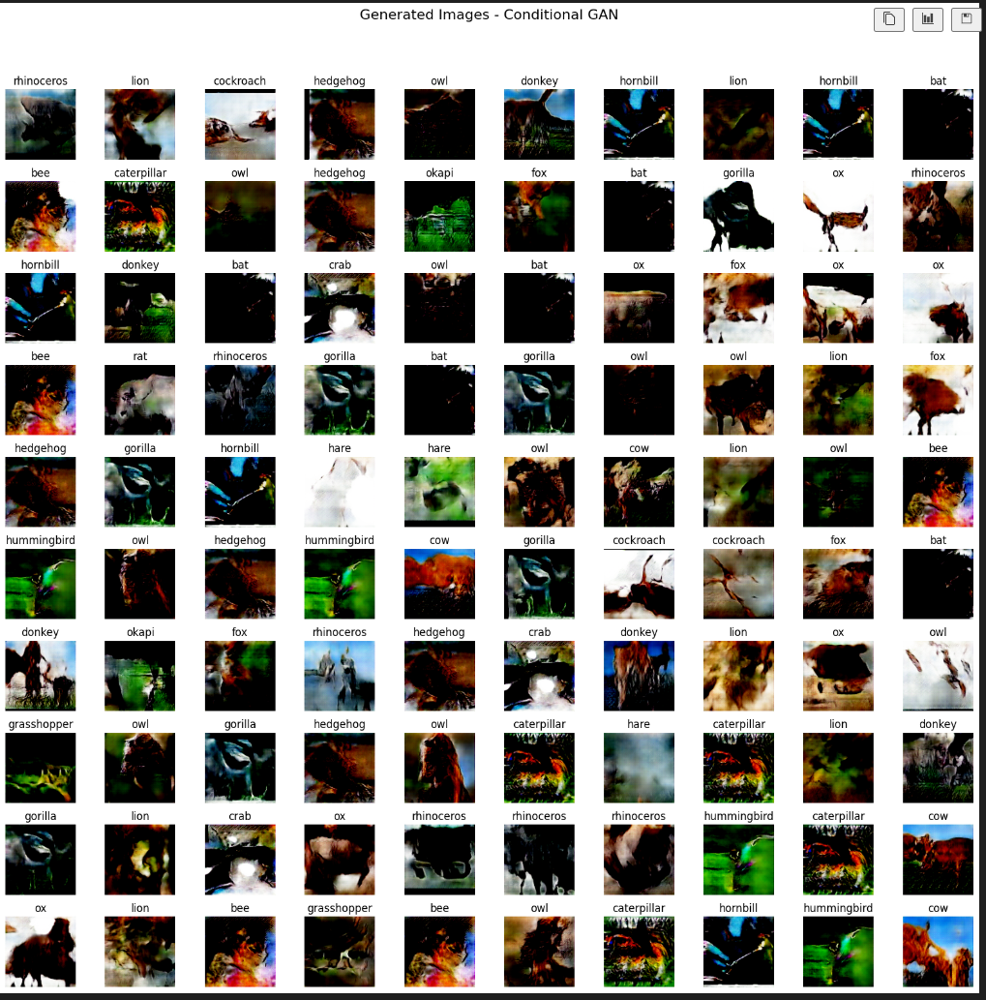

In [104]:
# plot loss of generator and discriminator COND GAN
# plotting the loss function
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training when discriminator is trained 2 times")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

generator and discriminator loss while training cgan.

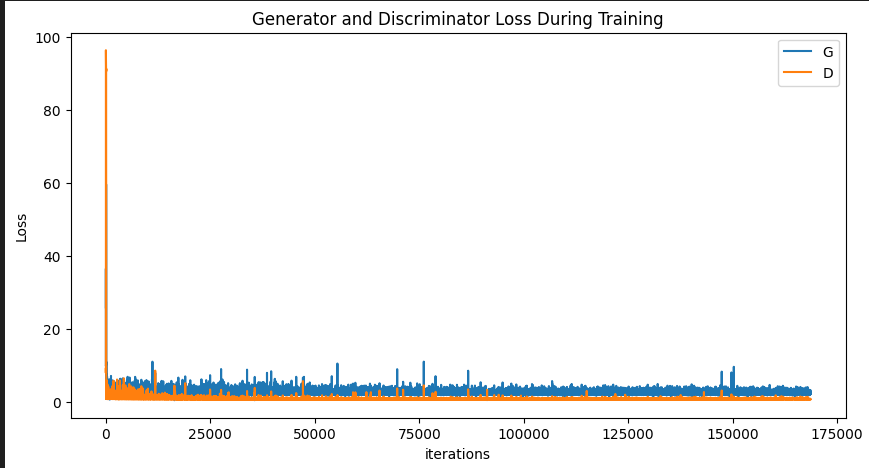

In [ ]:
#qun1 training on all dataset we did data augumentation 
#make size of each class to 600 images 
# and train using wgan and calculated the fid score


## QUN 7 TRAINED THE WGAN MODELS AND RECOMPUTE THE FID SCORE.
WE TRAINED DIFFERENT MODELS AND CALCULATED THEIR FID SCORES.
1. WGAN WITH WEIGHT CLIPPING ON BUTTERFLY DATASET.
2. WGAN WITH GRADIENT CLIPPING ON BUTTERFLY DATASET
3. WGAN WITH GRADIENT CLIPPING ON ENTIRE DATASET

Modify the loss and the Critic network to optimize the Wasserstein metric
and plot a 10 by 10 grid of generated images. Recompute the FID and
compare it with Vanilla GAN.

In [ ]:
#qun7 wgan on butterfly dataset
#trained busing two approaches. 
# with weight clippping and second with gradient penalty

# when use gradient clipping the same architecture is used as we use for dc gan
# and same dataloader is used to train model

In [115]:
# wgan generator amd critic and parameter initialisation

# Initialize the ``BCELoss`` function
criterion = nn.BCELoss()

wganG = Generator_dcgan().to(device)
wganG.apply(weights_init)

# Create the Discriminator
critic = Discriminator_dcgan().to(device)    
critic.apply(weights_init)

lr = 0.00005

# Setup Adam optimizers for both G and D
optimizerG = optim.RMSprop(netG.parameters(), lr=lr)
opt_critic = optim.RMSprop(critic.parameters(), lr=lr)

In [177]:
# training the wgan model on butterfly dataset usd weightclipping
# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0
critic_iteration = 5
weight_clip = 0.01


num_epochs = 100

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(butt_dataloader, 0):
        
        #train critic for critic_iteration times
        for _ in range(critic_iteration):
            critic.zero_grad()
        
            real_img = data.to(device)
            b_size = real_img.size(0)
            noise = torch.randn(b_size, nz, 1, 1, device=device)
            fake_img = netG(noise)   

            output_real = critic(real_img).view(-1)   
            output_fake = critic(fake_img).view(-1)

            loss_critic = -(torch.mean(output_real) - torch.mean(output_fake))
            loss_critic.backward(retain_graph=True)
            opt_critic.step()
            
            for p in critic.parameters():
                p.data.clamp_(-weight_clip, weight_clip)

        
        #train generator
        netG.zero_grad()
        
        output_fake = critic(fake_img).view(-1)
        loss_gen = - torch.mean(output_fake)
        loss_gen.backward()
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print("generator loss: ", loss_gen.item(), " critic loss: ", loss_critic.item())

        # Save Losses for plotting later
        G_losses.append(loss_gen.item())
        D_losses.append(loss_critic.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(butt_dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

            plt.figure(figsize=(8, 8))
            plt.axis("off")
            plt.title("Generated Images")
            plt.imshow(np.transpose(vutils.make_grid(fake, padding=2, normalize=True), (1, 2, 0)))
            plt.show() 

        iters += 1


# save the generator model
torch.save(netG.state_dict(), 'final/generator/gen_wgan_butter.pth')
# save the discriminator model
torch.save(critic.state_dict(), 'final/discriminator/disc_wgan_butter.pth')  

/tmp/ipykernel_1726230/3644598386.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  wganG_butt_trained.load_state_dict(torch.load('final/generator/gen_wgan_gcl_butter.pth'

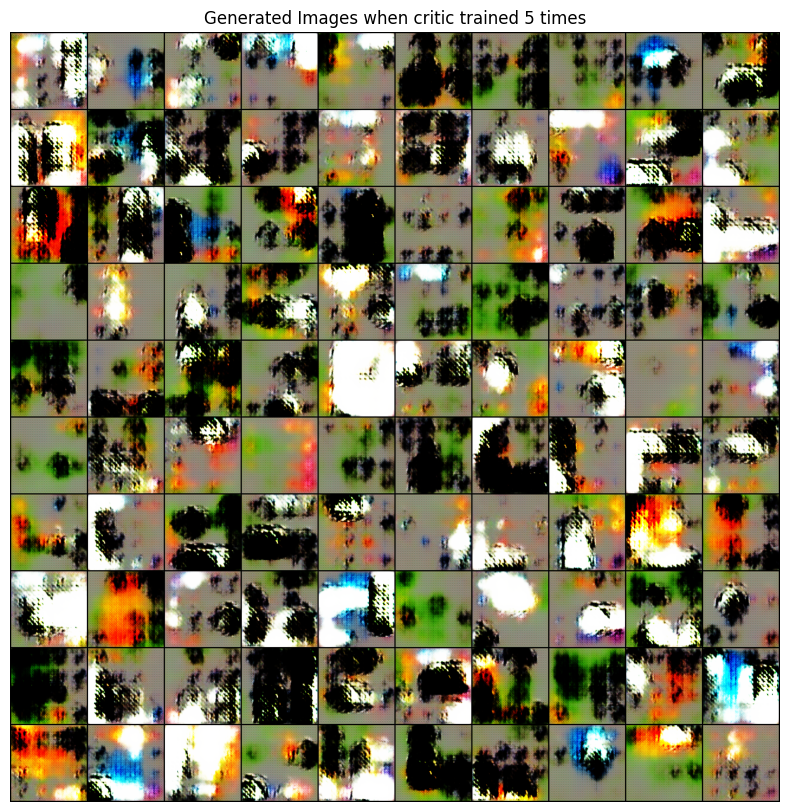

In [108]:
# load the model and plot the generated images
wganG_butt_trained = Generator_dcgan().to(device)
wganG_butt_trained.load_state_dict(torch.load('final/generator/gen_wgan_gcl_butter.pth'))

fixed_noise_gen = torch.randn(100, nz, 1, 1, device=device)
with torch.no_grad():
    fake = wganG_butt_trained(fixed_noise_gen).detach().cpu()
    img_list.append(vutils.make_grid(fake, nrow=10, padding=2, normalize=True))

    plt.figure(figsize=(10, 10))
    plt.axis("off")
    plt.title("Generated Images when critic trained 5 times")   
    plt.imshow(np.transpose(img_list[-1], (1, 2, 0)))
    plt.show()


generated images of butterfly from wgan. training of wgan is more stable than the dcgan. can improve the result if do more hyperparameter tunning.

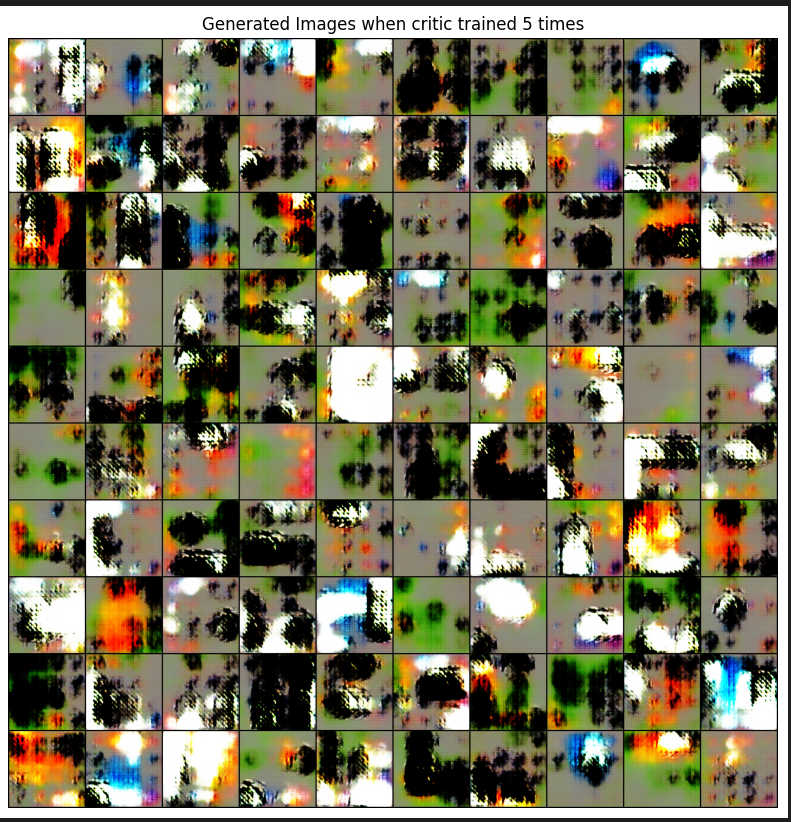

In [87]:
# calculate the fid score
#calculate fid score of wgan trained on all animal dataset
# to calculate fid we need to generate the 1000 real samples and 1000 fake samples.

real_batch = []
animal_size = 1000

for batch in butt_dataloader:
    images= batch
    real_batch.append(images)
    if len(real_batch) * images.size(0) >= animal_size:
        break
    
real_images = torch.cat(real_batch)[:animal_size]
# print(real_batch.shape)

# Generate fake images using the generator model
latent_dim = 100

wgan_wcl = Generator_dcgan()
wgan_wcl.load_state_dict(torch.load('final/generator/gen_wgan_gcl_butter.pth'))

latent_vector = torch.randn(1000, latent_dim, 1, 1)
fake_images = wgan_wcl(latent_vector).detach()

fid_score = calculate_fid(real_images, fake_images)
print(f"FID Score: {fid_score}")

/tmp/ipykernel_1726230/1542958321.py:21: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  wgan_wcl.load_state_dict(torch.load('final/generator/gen_wgan_gcl_butter.pth'))
/home/

FID Score: 107.91295449873817


get FID Score: 107.9 on butterfly dataset when trained wgan. use weight clipping to train.

In [ ]:
#wgan with gp on butterfly dataset

wganbGP = Generator_dcgan().to(device)
wganbGP.apply(weights_init)

# Create the Discriminator
criticGP = Discriminator_dcgan().to(device)    
criticGP.apply(weights_init)

#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Learning rate for optimizers
lr = 0.0001
beta1 = 0
beta2 = 0.9

# Setup Adam optimizers for both G and D
optimizerG = optim.Adam(wganbGP.parameters(), lr=lr, betas=(beta1, beta2))
opt_critic = optim.Adam(criticGP.parameters(), lr=lr, betas=(beta1, beta2))

In [ ]:
#gradient penalty function
def gradient_penalty(critic, real, fake, device='cpu'):
    BATCH_SIZE, C, H, W = real.shape
    epsilon = torch.rand(BATCH_SIZE, 1, 1, 1).repeat(1, C, H, W).to(device)
    interpolated_images = real * epsilon + fake * (1 - epsilon)

    # calculate critic score 
    mixed_scores = critic(interpolated_images)

    gradients = torch.autograd.grad(
        inputs = interpolated_images,
        outputs = mixed_scores,
        grad_outputs = torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    
    gradients = gradients.view(gradients.shape[0], -1)
    gradient_norm = gradients.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1)**2)

    return gradient_penalty

In [ ]:
# Training ON BUTTERFLY WGAN gradient penalty

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0
critic_iteration = 5
weight_clip = 0.01
grad_pen_lamb = 10

num_epochs = 40

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(butt_dataloader, 0):
        
        #train critic for critic_iteration times
        for _ in range(critic_iteration):
            critic.zero_grad()
        
            real_img = data.to(device)
            b_size = real_img.size(0)
            
            noise = torch.randn(b_size, nz, 1, 1, device=device)
            fake_img = netG(noise)   
            gp = gradient_penalty(critic, real_img, fake_img, device=device)
            output_real = critic(real_img).view(-1)   
            output_fake = critic(fake_img).view(-1)

            loss_critic = -(torch.mean(output_real) - torch.mean(output_fake)) + grad_pen_lamb * gp
            loss_critic.backward(retain_graph=True)
            opt_critic.step()
            
            # for p in critic.parameters():
            #     p.data.clamp_(-weight_clip, weight_clip)

        
        #train generator
        netG.zero_grad()
        
        output_fake = critic(fake_img).view(-1)
        loss_gen = - torch.mean(output_fake)
        loss_gen.backward()
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print("generator loss: ", loss_gen.item(), " critic loss: ", loss_critic.item())

        # Save Losses for plotting later
        G_losses.append(loss_gen.item())
        D_losses.append(loss_critic.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(butt_dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

            plt.figure(figsize=(8, 8))
            plt.axis("off")
            plt.title("Generated Images")
            plt.imshow(np.transpose(vutils.make_grid(fake, padding=2, normalize=True), (1, 2, 0)))
            plt.show() 

        iters += 1


# save the generator model
torch.save(netG.state_dict(), 'final/generator/gen_wgangp_butter.pth')
# save the discriminator model
torch.save(critic.state_dict(), 'final/generator/disc_wgangp_butter.pth')        

/tmp/ipykernel_1726230/2540922421.py:4: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  wganGP_trained.load_state_dict(torch.load('final/generator/gen_wgangp_butter.pth'))


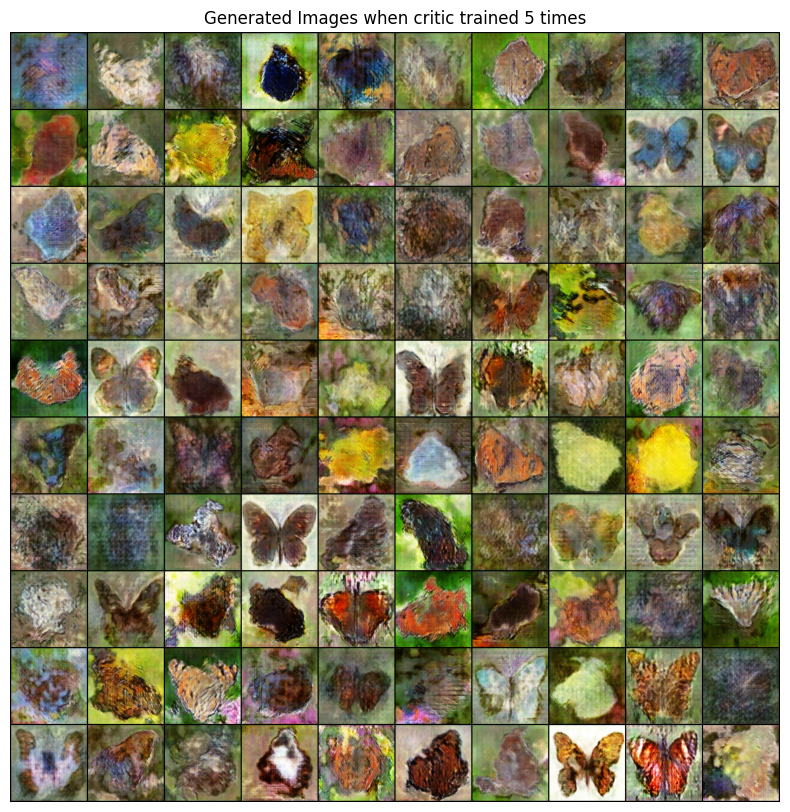

In [107]:
#load the model and plot generated images

wganGP_trained = Generator_dcgan().to(device)
wganGP_trained.load_state_dict(torch.load('final/generator/gen_wgangp_butter.pth'))

fixed_noise_gen = torch.randn(100, nz, 1, 1, device=device)
img_list = []
with torch.no_grad():
    fake = wganGP_trained(fixed_noise_gen).detach().cpu()
    img_list.append(vutils.make_grid(fake, nrow=10, padding=2, normalize=True))

    plt.figure(figsize=(10, 10))
    plt.axis("off")
    plt.title("Generated Images when critic trained 5 times")   
    plt.imshow(np.transpose(img_list[-1], (1, 2, 0)))
    plt.show()

wgan image generation on butterfly dataset.

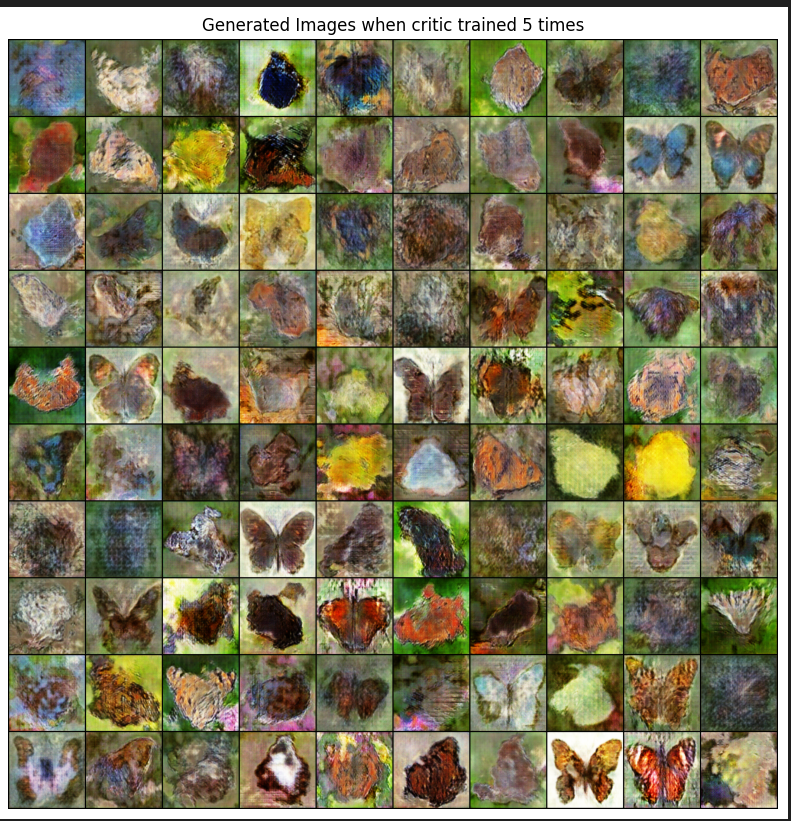

In [92]:
#calculate fid of wgan gp on butterfly dataset
#calculate fid score of wgan trained on all animal dataset
# to calculate fid we need to generate the 1000 real samples and 1000 fake samples.

real_batch = []
animal_size = 1000

for batch in butt_dataloader:
    images= batch 
    real_batch.append(images)
    if len(real_batch) * images.size(0) >= animal_size:
        break
    
real_images = torch.cat(real_batch)[:animal_size]
# print(real_batch.shape)

# Generate fake images using the generator model
latent_dim = 100

wgan_gcp_butt = Generator_dcgan()
wgan_gcp_butt.load_state_dict(torch.load('final/generator/gen_wgangp_butter.pth'))

latent_vector = torch.randn(1000, latent_dim, 1, 1)
fake_images = wgan_gcp_butt(latent_vector).detach()

fid_score = calculate_fid(real_images, fake_images)
print(f"FID Score: {fid_score}")

/tmp/ipykernel_1726230/230628788.py:21: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  wgan_gcp_butt.load_state_dict(torch.load('final/generator/gen_wgangp_butter.pth'))
/hom

FID Score: 95.96009356468473


get FID Score: 95.9 when trained wgan on butterfly dataset using gradient clipping

training dcgan on animal dataset , calculating fid,
only need to change the number of classes to 90 to get data loading.
the generator and discriminator network is same that of butterfly. only need to change dataset and train. thats it

## QUN 8TH STARTED. RECONSTRUCT THE INPUT Z FROM THHE GENERATED IMAGES USED DECODER NETWORK TO GENERATE THE Z VECTOR.

Implement a decoder network - with input as generated images that outputs the input random variable in the GAN. Add a norm-based reconstruction loss between the input to the generator and the output of the
decoder. Train it simultaneously along with regular GAN losses.

{0: 'bee', 1: 'caterpillar', 2: 'rat', 3: 'ox', 4: 'hummingbird', 5: 'crab', 6: 'cockroach', 7: 'fox', 8: 'okapi', 9: 'cow', 10: 'hornbill', 11: 'donkey', 12: 'hare', 13: 'rhinoceros', 14: 'gorilla', 15: 'owl', 16: 'bat', 17: 'grasshopper', 18: 'hedgehog', 19: 'lion'}
tensor([74,  6,  2, 84, 23, 85, 15, 24, 71, 60, 71, 34, 12, 76, 62, 32, 13, 21,
        22, 57, 69, 51, 44, 58, 68, 47, 23, 47,  1, 86, 23, 60, 42, 44, 72, 51,
        13, 49, 23, 56, 29, 57, 79, 55,  6, 47, 25,  5, 53, 86, 33, 21, 61, 12,
        63, 80, 78, 14, 63, 13, 28, 86, 72, 82])
64


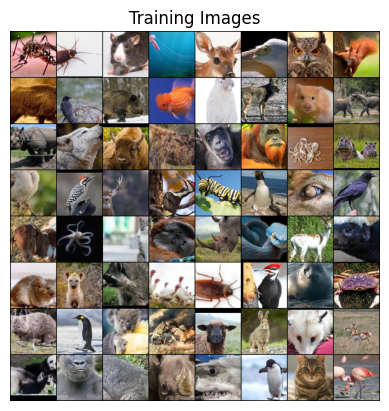

In [25]:
#train entire dataset on dcgan 
num_classes = 90
dataset_animal = CustomDataset_conditional_Gan(dataroot=dataroot_animals,num_classes=num_classes,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader

animal_dict = dataset_cgan.get_animal_dict()
print(animal_dict)
dataloader_animal = torch.utils.data.DataLoader(dataset_animal, batch_size=batch_size, shuffle=True, num_workers = 8, drop_last=True)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available()) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader_animal))
print(real_batch[1])
print(len(real_batch[1]))
# plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()

In [ ]:
#creating the decoder model for latent reconstructiuon
class Decoder(nn.Module):
    def __init__(self):
        super(Decoder, self).__init__()
        self.main = nn.Sequential(
            # input is (nc) x 128 x 128
            nn.Conv2d(nc, ndf, 4, stride=2, padding=1, bias=False), 
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 64 x 64
            nn.Conv2d(ndf, ndf * 2, 4, stride=2, padding=1, bias=False),
            nn.InstanceNorm2d(ndf * 2, affine=True),
            nn.LeakyReLU(0.2),
            # state size. (ndf*2) x 32 x 32
            nn.Conv2d(ndf * 2, ndf * 4, 4, stride=2, padding=1, bias=False),
            nn.InstanceNorm2d(ndf * 4, affine=True),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 16 x 16 
            nn.Conv2d(ndf * 4, ndf * 8, 4, stride=2, padding=1, bias=False),
            nn.InstanceNorm2d(ndf * 8, affine=True),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 8 x 8
            nn.Conv2d(ndf * 8, ndf * 16, 4, stride=2, padding=1, bias=False),
            nn.InstanceNorm2d(ndf * 16, affine=True),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*16) x 4 x 4
            nn.Conv2d(ndf * 16, 100, 4, stride=1, padding=0, bias=False),
          
            # state size. 1
        )

    def forward(self, input):
        return self.main(input)

In [ ]:
# model creation generator amd discriminator and decoder a

criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 0.9
fake_label = 0.1
dcgen_animal = Generator_dcgan().to(device)
dcgen_animal.apply(weights_init)

# Create the Discriminator
dcdes_animal = Discriminator_dcgan().to(device)    
dcdes_animal.apply(weights_init)

# Create the Discriminator
decoder_dcgan = Decoder().to(device)
decoder_dcgan.apply(weights_init)
criterion_dec = nn.MSELoss()

# Setup Adam optimizers for both G and D
optimizerG = optim.Adam(dcgen_animal.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerD = optim.Adam(dcdes_animal.parameters(), lr=lr, betas=(beta1, 0.999))
opt_decoder = optim.Adam(decoder_dcgan.parameters(), lr=lr)

In [ ]:
# Training dcgan on animal dataset

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0
k = 2
num_epochs = 50

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    for i, data in enumerate(dataloader_animal, 0):
        # training the discriminator k times
        for _ in range(k):
            dcdes_animal.zero_grad()
            real_image = data[0].to(device)
            batch_size = real_image.size(0)
            label = torch.full((batch_size,), real_label, dtype=torch.float, device=device)
            # print("label shape  ", label.shape)
            # Forward pass real batch through D
            output_real = dcdes_animal(real_image).view(-1)
            # print("output shape  ", output.shape)
                        
            errD_real = criterion(output_real, label)
            errD_real.backward()
            D_x = output_real.mean().item()
            noise = torch.randn(batch_size, nz, 1, 1, device=device)
            fake_image = dcgen_animal(noise)
            label.fill_(fake_label)
            output_fake = dcdes_animal(fake_image.detach()).view(-1)
            errD_fake = criterion(output_fake, label)
            errD_fake.backward()
            D_G_z1 = output_fake.mean().item()
            errD = errD_real + errD_fake
            optimizerD.step()

        
        #train the generator
        dcgen_animal.zero_grad()
        label.fill_(real_label) 
        output_fake = dcdes_animal(fake_image).view(-1)
        errG = criterion(output_fake, label)
        errG.backward()
        D_G_z2 = output_fake.mean().item()
        optimizerG.step()

        #train decoder
        noise = torch.randn(batch_size, nz, 1, 1, device=device)
        fake_img = dcgen_animal(noise)  

        decoder_dcgan.zero_grad()
        output_dec = decoder_dcgan(fake_img)
        loss_dec = criterion_dec(noise, output_dec)
        loss_dec.backward()
        opt_decoder.step()

        # Output training stats
        if i % 300 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader_animal),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader_animal)-1)):
            with torch.no_grad():
                fake = dcgen_animal(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

            plt.figure(figsize=(8, 8))
            plt.axis("off")
            plt.title("Generated Images")
            plt.imshow(np.transpose(vutils.make_grid(fake, padding=2, normalize=True), (1, 2, 0)))
            plt.show() 

        iters += 1


# save the generator model
torch.save(dcgen_animal.state_dict(), 'final/generator/dcgan_gen_animal.pth')
# save the discriminator model
torch.save(dcdes_animal.state_dict(), 'final/discriminator/dcgan_des_animal.pth')

/tmp/ipykernel_1726230/1965557595.py:4: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  dcgan_animal_trained.load_state_dict(torch.load('final/generator/dcgan_gen_animal.pth')

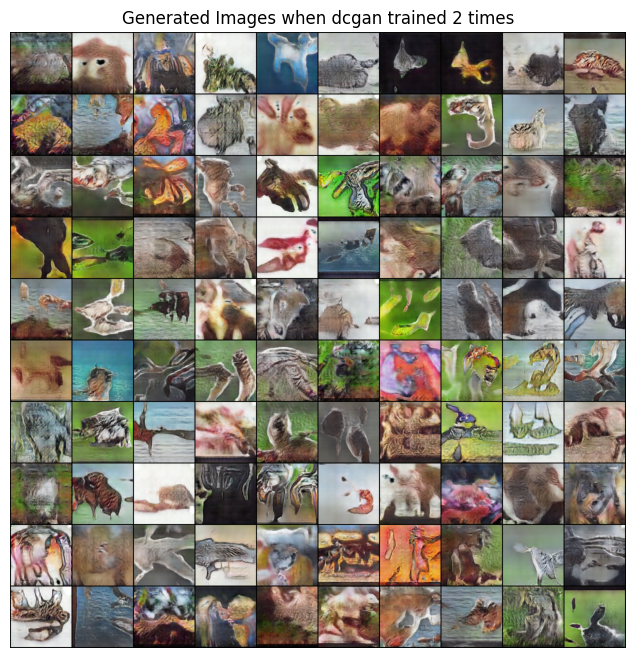

In [67]:
#load model, and generate the  images animal dc gan

dcgan_animal_trained = Generator_dcgan().to(device)
dcgan_animal_trained.load_state_dict(torch.load('final/generator/dcgan_gen_animal.pth'))

fixed_noise_gen = torch.randn(100, nz, 1, 1, device=device)
img_list = []
with torch.no_grad():
    fake = dcgan_animal_trained(fixed_noise_gen).detach().cpu()
    img_list.append(vutils.make_grid(fake, nrow=10, padding=2, normalize=True))

    plt.figure(figsize=(8, 8))
    plt.axis("off")
    plt.title("Generated Images when dcgan trained 2 times")   
    plt.imshow(np.transpose(img_list[-1], (1, 2, 0)))
    plt.show()

dcgan on animal dataset. below are image generation.

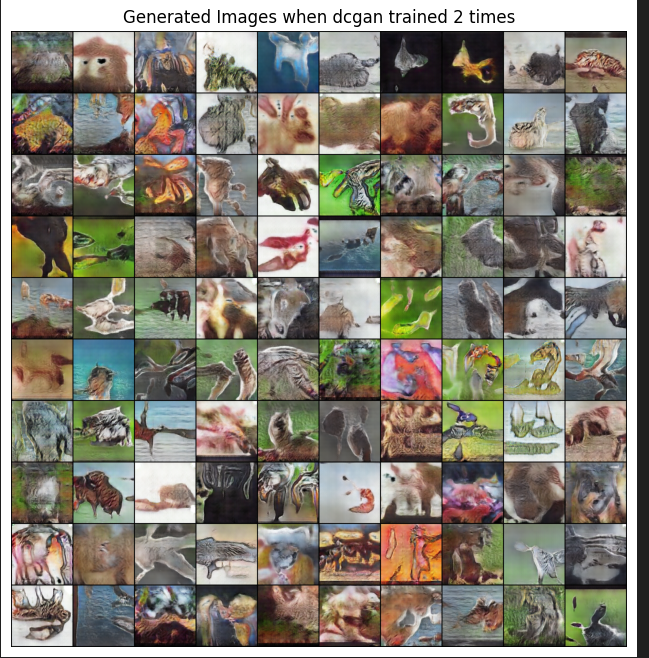

In [ ]:
#qun plot loss of generator and discriminator
#plotting the loss function
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training when discriminator is trained 2 times")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

trained dcgan, when descriminator trained 2 times and generator one time. 
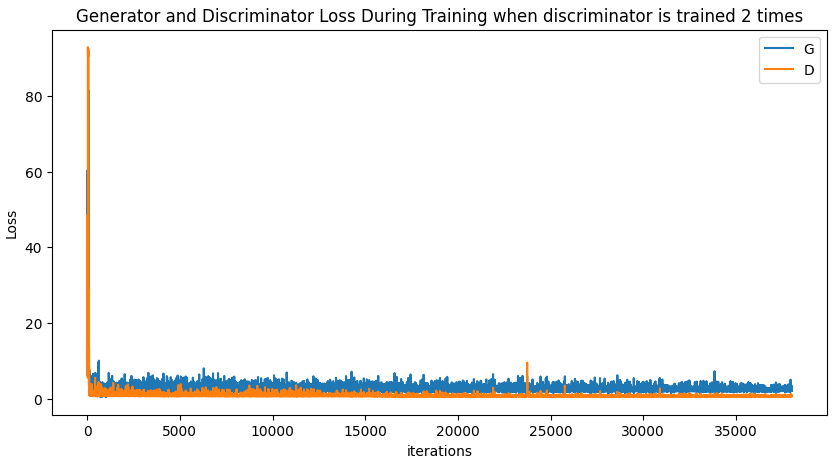

dc gan decoder loss ve iterations.

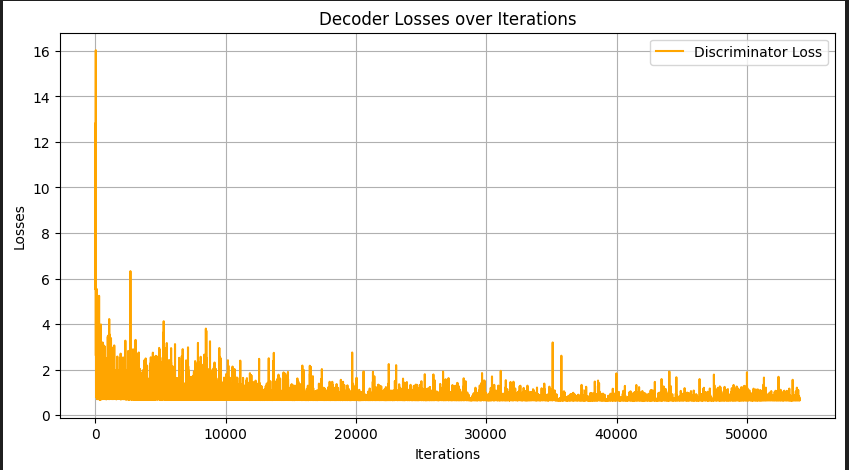

{0: 'bee', 1: 'caterpillar', 2: 'rat', 3: 'ox', 4: 'hummingbird', 5: 'crab', 6: 'cockroach', 7: 'fox', 8: 'okapi', 9: 'cow', 10: 'hornbill', 11: 'donkey', 12: 'hare', 13: 'rhinoceros', 14: 'gorilla', 15: 'owl', 16: 'bat', 17: 'grasshopper', 18: 'hedgehog', 19: 'lion'}
tensor([16, 39, 84, 87, 17, 83, 39, 30, 16, 82,  9, 70, 73, 48, 80, 33, 74, 65,
        25, 83,  6,  5,  1, 42,  7, 44, 67, 43, 75, 64, 26, 46, 14, 12, 17, 13,
        74, 83, 25, 10, 84, 33, 62, 46, 89, 75, 24, 14, 76,  4, 82, 46, 56, 17,
         2, 85,  5,  9, 64, 69, 53, 74, 67, 35])
64


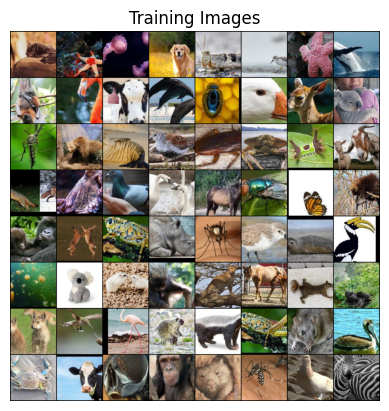

In [57]:
#orignal animal dataset to calculate fid score

dataroot = "animals"
#train entire dataset on dcgan 
num_classes = 90
dataset_animal = CustomDataset_conditional_Gan(dataroot=dataroot_animals,num_classes=num_classes,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader

animal_dict = dataset_cgan.get_animal_dict()
print(animal_dict)
dataloader_animal = torch.utils.data.DataLoader(dataset_animal, batch_size=batch_size, shuffle=True, drop_last=True)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available()) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader_animal))
print(real_batch[1])
print(len(real_batch[1]))
# plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()

In [68]:
#calulate and compare the fid score of the dcgan trained model on animal dataset
# Fetch real images from the data loader
#to calculate the fid score use orignal images(right now you have used 
# augumented images but need to use the orignal images given by sir.

real_batch = []
animal_size = 1000

for batch in dataloader_animal:
    images= batch[0]  
    real_batch.append(images)
    if len(real_batch) * images.size(0) >= animal_size:
        break
    
real_images = torch.cat(real_batch)[:animal_size]
# print(real_batch.shape)

# Generate fake images using the generator model
latent_dim = 100

dcgan_animal_trained = Generator_dcgan()
dcgan_animal_trained.load_state_dict(torch.load('final/generator/dcgan_gen_animal.pth'))

latent_vector = torch.randn(1000, latent_dim, 1, 1)
fake_images = dcgan_animal_trained (latent_vector).detach()

fid_score = calculate_fid(real_images, fake_images)
print(f"FID Score: {fid_score}")

/tmp/ipykernel_1726230/13829401.py:22: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  dcgan_animal_trained.load_state_dict(torch.load('final/generator/dcgan_gen_animal.pth'))

FID Score: 67.09303880731463


For dc gan FID Score: 67.09303880731463 trained on animal datset. all 90 classes

Created latent space reconstruction using the wgan on entire dataset. and then computed fid

In [12]:
# generator , discriminator and decoder model creation and parameter initialization
# trained wgan on all animal data.
# for animal data to train wgan used same d=structure but trained only with gradient clipping.
# 

gen_wgangp_animal =  Generator_dcgan().to(device)
gen_wgangp_animal.apply(weights_init)

# Create the Discriminator
critic_wgangp_animal = Discriminator_dcgan().to(device)    
critic_wgangp_animal.apply(weights_init)

# Create the Discriminator
decoder = Decoder().to(device)
decoder.apply(weights_init)

criterion_dec = nn.MSELoss()

# Learning rate for optimizers
lr = 0.0001
beta1 = 0
beta2 = 0.9

# Setup Adam optimizers for both G and D
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, beta2))
opt_critic = optim.Adam(critic.parameters(), lr=lr, betas=(beta1, beta2))
opt_decoder = optim.Adam(decoder.parameters(), lr=lr)


Decoder(
  (main): Sequential(
    (0): Conv2d(3, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
    (4): LeakyReLU(negative_slope=0.2)
    (5): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): InstanceNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(512, 1024, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): InstanceNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(1024, 2048, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (12): InstanceNorm2d(2048, eps=1e-05

In [ ]:
# Training wgan animal dataset with decoder for latent reconstruction

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0
critic_iteration = 5
weight_clip = 0.01
grad_pen_lamb = 10

num_epochs = 1

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader_animal, 0):
        
        #train critic for critic_iteration times
        for _ in range(critic_iteration):
            critic.zero_grad()
        
            real_img = data[0].to(device)
            b_size = real_img.size(0)
            noise = torch.randn(b_size, nz, 1, 1, device=device)
            fake_img = netG(noise)   
            gp = gradient_penalty(critic, real_img, fake_img, device=device)
            output_real = critic(real_img).view(-1)   
            output_fake = critic(fake_img).view(-1)

            loss_critic = -(torch.mean(output_real) - torch.mean(output_fake)) + grad_pen_lamb * gp
            loss_critic.backward(retain_graph=True)
            opt_critic.step()
            
            # for p in critic.parameters():
            #     p.data.clamp_(-weight_clip, weight_clip)

        
        #train generator
        netG.zero_grad()
        
        output_fake = critic(fake_img).view(-1)
        loss_gen = - torch.mean(output_fake)
        loss_gen.backward()
        optimizerG.step()

        #train decoder
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        fake_img = netG(noise)   
        decoder.zero_grad()
        output_dec = decoder(fake_img)
        loss_dec = criterion_dec(noise, output_dec)
        loss_dec.backward()
        opt_decoder.step()

        # Output training stats
        if i % 50 == 0:
            print("generator loss: ", loss_gen.item(), " critic loss: ", loss_critic.item(), " decoder loss: ", loss_dec.item())

        # Save Losses for plotting later
        G_losses.append(loss_gen.item())
        D_losses.append(loss_critic.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader_animal)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

            plt.figure(figsize=(8, 8))
            plt.axis("off")
            plt.title("Generated Images")
            plt.imshow(np.transpose(vutils.make_grid(fake, padding=2, normalize=True), (1, 2, 0)))
            plt.show() 

        iters += 1


# save the generator model
torch.save(netG.state_dict(), 'final/gen_wgan_all.pth')
# save the discriminator model
torch.save(critic.state_dict(), 'final/disc_wgan_all.pth')        
# save the decoder model
torch.save(critic.state_dict(), 'final/decoder_all.pth')  


/tmp/ipykernel_1726230/1775677919.py:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  gen_wgangp_animal.load_state_dict(torch.load('gen_wgan_all.pth'))


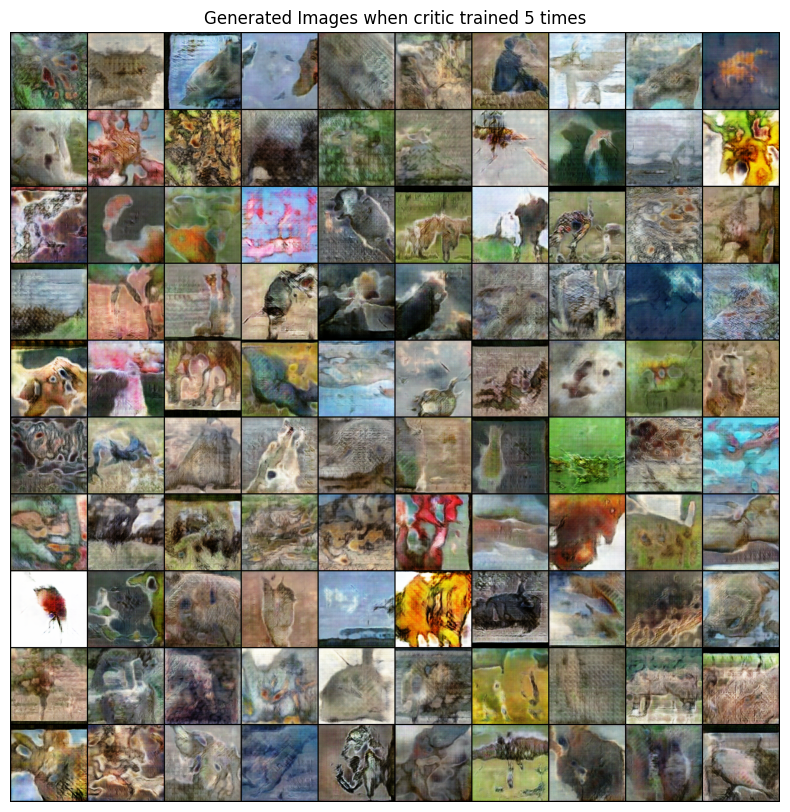

In [61]:
#images generated by6 wgan model.
gen_wgangp_animal.load_state_dict(torch.load('gen_wgan_all.pth'))

fixed_noise_gen = torch.randn(100, nz, 1, 1, device=device)
img_list = []
with torch.no_grad():
    fake = gen_wgangp_animal(fixed_noise_gen).detach().cpu()
    img_list.append(vutils.make_grid(fake, nrow=10, padding=2, normalize=True))

    plt.figure(figsize=(10, 10))
    plt.axis("off")
    plt.title("Generated Images when critic trained 5 times")   
    plt.imshow(np.transpose(img_list[-1], (1, 2, 0)))
    plt.show()

image generated when trained wgan on animal dataset. enforce the Lipschitz constraint on the discriminator using gradient penalty. gradient penalty replaces the weight clipping used in the WGAN. the gradient penalty method adds a penalty term to the loss function based on the gradients of the critic’s output.


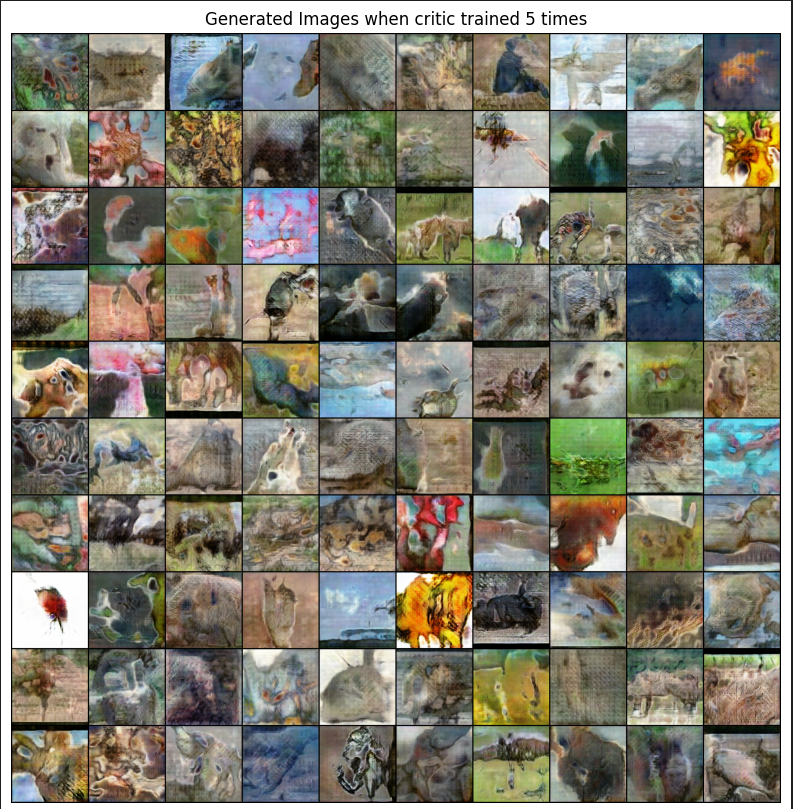

The gradient penalty leads to more stable training compared to weight clipping.
also gradient penalty not restrict the weights of the critic, which allow it expressive models, means weights can take any value not bounded..

In [64]:
#calculate fid score of wgan trained on all animal dataset
# to calculate fid we need to generate the 1000 real samples and 1000 fake samples.

real_batch = []
animal_size = 1000

for batch in dataloader_animal:
    images= batch[0]  
    real_batch.append(images)
    if len(real_batch) * images.size(0) >= animal_size:
        break
    
real_images = torch.cat(real_batch)[:animal_size]
# print(real_batch.shape)

# Generate fake images using the generator model
latent_dim = 100

gen_wgangp_animal = Generator_dcgan()
gen_wgangp_animal.load_state_dict(torch.load('final/generator/gen_wgan_all.pth'))

latent_vector = torch.randn(1000, latent_dim, 1, 1)
fake_images = gen_wgangp_animal(latent_vector).detach()

fid_score = calculate_fid(real_images, fake_images)
print(f"FID Score: {fid_score}")

/tmp/ipykernel_1726230/453372955.py:20: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  gen_wgangp_animal.load_state_dict(torch.load('gen_wgan_all.pth'))
/home/hb/.local/lib/p

FID Score: 73.05732913403789


get FID Score: 73.05732913403789 on real animal data when trained the wgan using gradient penalty


fid of wgan is higher than the fid of dc gan. But the wgan should give better result. need some parameter tuning the wgan will perform better than the dc gan because since WGAN uses a different loss function based on the Wasserstein distance, which measures how far two probability distributions are. This loss function provides smoother gradients and is less likely to saturate compared to the binary cross-entropy loss used in traditional GANs. As a result, training is generally more stable and converges faster.

we also created the decoder network which we will use in the next module for classification

## QUN NO 9 STARTED HERE


 Obtain the decoder output (trained in the previous step) for all the input
images. Train an MLP to solve a classification task by taking these decoded vectors as input. Compute and report the classification accuracy
and the F1 score.

{0: 'bee', 1: 'caterpillar', 2: 'rat', 3: 'ox', 4: 'hummingbird', 5: 'crab', 6: 'cockroach', 7: 'fox', 8: 'okapi', 9: 'cow', 10: 'hornbill', 11: 'donkey', 12: 'hare', 13: 'rhinoceros', 14: 'gorilla', 15: 'owl', 16: 'bat', 17: 'grasshopper', 18: 'hedgehog', 19: 'lion', 20: 'seahorse', 21: 'wolf', 22: 'bison', 23: 'deer', 24: 'squirrel', 25: 'seal', 26: 'butterfly', 27: 'moth', 28: 'shark', 29: 'mouse', 30: 'whale', 31: 'eagle', 32: 'elephant', 33: 'koala', 34: 'goldfish', 35: 'zebra', 36: 'tiger', 37: 'lizard', 38: 'pig', 39: 'starfish', 40: 'ladybugs', 41: 'turtle', 42: 'goat', 43: 'swan', 44: 'octopus', 45: 'kangaroo', 46: 'porcupine', 47: 'woodpecker', 48: 'goose', 49: 'snake', 50: 'oyster', 51: 'orangutan', 52: 'parrot', 53: 'wombat', 54: 'squid', 55: 'turkey', 56: 'badger', 57: 'hyena', 58: 'hippopotamus', 59: 'otter', 60: 'crow', 61: 'sheep', 62: 'hamster', 63: 'possum', 64: 'fly', 65: 'bear', 66: 'lobster', 67: 'pigeon', 68: 'sparrow', 69: 'chimpanzee', 70: 'dolphin', 71: 'boar',

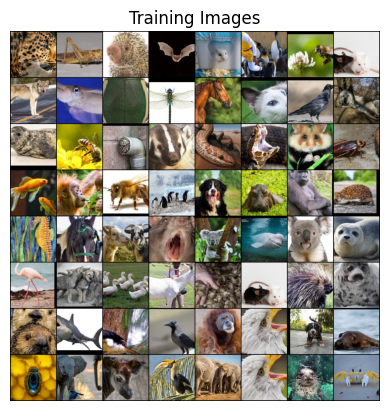

In [45]:
#QUN NO 9

dataroot = "/home/hb/Documents/adrl_assignment/assignment1/animals"
num_classes = 90
embed_size = 100


dataset = CustomDataset_conditional_Gan(dataroot=dataroot,num_classes=num_classes,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader


# NEED TO SPLIT the data set into train , validation and test set
#  train size contains 80% of the data, validation contains 10% and test contains 10%

train_size = int(0.8 * len(dataset))
val_size = int(0.1 * len(dataset))
test_size = len(dataset) - train_size - val_size

# split first 80% of the data for training, next 10% for validation and last 10% for testing
train_dataset, val_dataset, test_dataset = torch.utils.data.random_split(dataset, [train_size, val_size, test_size])



animal_dict = dataset.get_animal_dict()
print(animal_dict)
train_dataloader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True, drop_last=True)
val_dataloader = torch.utils.data.DataLoader(val_dataset, batch_size=batch_size, shuffle=True, drop_last=True)
test_dataloader = torch.utils.data.DataLoader(test_dataset, batch_size=batch_size, shuffle=True, drop_last=True)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available()) else "cpu")

# Plot some training images
real_batch = next(iter(train_dataloader))
print(real_batch[1])
# plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()

In [17]:
# qun 9th using this decoder model we trained above
# now we have to pass the input image to the decoder and get that output (latent vector of image)
# now we pass that vector to the mlp classifier and check accuracy and f1 scores.


class mlp_classifier(nn.Module):
    def __init__(self, embed_size, num_classes, dropout = 0.5):
        super(mlp_classifier, self).__init__()
        
        self.embed_size = embed_size
        self.num_classes = num_classes
        self.dropout = dropout

        self.mlp = nn.Sequential(
            self.block(embed_size, 512),
            self.block(512, 1024),
            self.block(1024, 512),
            self.block(512, 256),
            self.block(256, num_classes)
        )
        # self.fc = nn.Linear(256, num_classes)

    def block(self, i_dim, o_dim):
        return nn.Sequential(
            nn.Linear(i_dim, o_dim),
            nn.BatchNorm1d(o_dim),
            nn.Tanh(),
            nn.Dropout(self.dropout)
        )    
    
    def forward(self, x):
        #input shape batch*hidden_dim
     
        return self.mlp(x)

In [113]:
# we need to create the mlp classifieer model
# which will take the input latent vector and predict the class of the image
# loss is crossentropy loss
# my mlp will give output which has shape of [batch_size , total number of classes]
# and the tarerget will have class indices of shape [batch_size]
# so in cross entropy loss we can pass the output and target directly

criterion_mlp = nn.CrossEntropyLoss()
embed_size = 100
num_classes = 90
# Learning rate for optimizers
lr = 0.0001

# load decoder model saved as decoder_all.pth
decoder = Decoder().to(device)
decoder.load_state_dict(torch.load('backups/dcgan_decoder_animal.pth'))

# creating the mlp model
mlp = mlp_classifier(embed_size, num_classes).to(device)


opt_mlp = optim.Adam(mlp.parameters(), lr=lr)


/tmp/ipykernel_1726230/1576028868.py:16: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  decoder.load_state_dict(torch.load('final/generator/decoder_all.pth'))


In [28]:
# training the mlp model for classification
# we first pass input image to the decoder to get latent vector
# no need to train the decoder as it is already trained
# used early stopping to stop the training when validation loss is not decreasing for 10 consecutive iterations
# and save the model when validation loss is minimum
# also predict accuracy precision and f1 score on validation set and test set


from sklearn.metrics import classification_report, accuracy_score


train_loss = []
val_loss = []


num_epoches  =  40
min_val_loss = np.inf
patience = 10
count = 0

for epoch in range(num_epoches):
        tr_loss = 0
        mlp.train()
        for i, data in enumerate(train_dataloader):
            image = data[0].to(device)
            target = data[1].to(device)

            decoder.eval()
            with torch.no_grad():
                latent_vector = decoder(image).view(-1, embed_size)
                # latent vector has shape of [batch_size, embed_size]
                # print(latent_vector.shape)   --- running correctly upto here
            
            mlp.zero_grad()
            output = mlp(latent_vector)
            #print(output.shape)
            # output has shape of [batch_size, num_classes] -checked
            loss = criterion_mlp(output, target) 
            tr_loss += loss.item()
            loss.backward()
            opt_mlp.step()
            
            if i%200 == 0:
                print("training loss: ", loss.item())
        
      
        tr_loss = tr_loss/(i+1)
        train_loss.append(tr_loss)
            
            # check validation loss and save model when validation loss is minimum.
            # and ww will save the train and validation loss for plotting

    
        with torch.no_grad():
            mlp.eval()
            vald_loss = 0
            y_true = []
            y_pred = []
            for i, data in enumerate(val_dataloader):
                    image_val = data[0].to(device)
                    target_val = data[1].to(device)
                    latent_vector_val = decoder(image_val).view(-1, embed_size)
                    output_val = mlp(latent_vector_val)
                    loss_val = criterion_mlp(output_val, target_val)
                    vald_loss += loss_val.item()

                    y_true = np.concatenate((y_true, target_val.cpu().numpy()))
                    y_pred = np.concatenate((y_pred, torch.argmax(output_val, dim=1).cpu().numpy()))
            
            vald_loss = vald_loss/(i+1)
            val_loss.append(vald_loss)

            if vald_loss < min_val_loss:
                min_val_loss = vald_loss
                torch.save(mlp.state_dict(), 'mlp_classifier.pth')
                count = 0
            else:
                count += 1
                if count == patience:
                    break     # break here will break the inner loop and go to nexr epoch

        
        
            
        # Calculate accuracy precision and f1 scores
        # Generate classification report using sklearn


        accuracy = accuracy_score(y_true, y_pred)
        target_names=[animal_dict[i] for i in range(num_classes)]

        report = classification_report(y_true, y_pred, target_names=target_names, output_dict=True)
       
        weighted_precision = report['weighted avg']['precision']
        weighted_recall = report['weighted avg']['recall']
        weighted_f1 = report['weighted avg']['f1-score']

        print("training loss  ",tr_loss, "  validation loss: ", vald_loss) 
        print(f'Accuracy: {accuracy:.2f}')
        print(f'Weighted Precision: {weighted_precision:.2f}')
        print(f'Weighted Recall: {weighted_recall:.2f}')
        print(f'Weighted F1 Score: {weighted_f1:.2f}')


In [31]:
#test the accuracy of mlp model on test set

from sklearn.metrics import classification_report, accuracy_score
# we will load the mlp classifier model and test the model on test set
decoder = Decoder().to(device)
decoder.load_state_dict(torch.load('final/decoder_all.pth'))

mlp = mlp_classifier(embed_size, num_classes).to(device)
mlp.load_state_dict(torch.load('mlp_classifier.pth'))



y_true = []
y_pred = []
for i, data in enumerate(test_dataloader):
    image_val = data[0].to(device)
    target_val = data[1].to(device)
    y_true = np.concatenate((y_true, target_val.cpu().numpy()))
    y_pred = np.concatenate((y_pred, torch.argmax(output_val, dim=1).cpu().numpy()))


# Calculate accuracy
accuracy = accuracy_score(y_true, y_pred)
target_names=[animal_dict[i] for i in range(num_classes)]

# Generate classification report
report = classification_report(y_true, y_pred, target_names=target_names, output_dict=True)

# Extract weighted metrics
weighted_precision = report['weighted avg']['precision']
weighted_recall = report['weighted avg']['recall']
weighted_f1 = report['weighted avg']['f1-score']


print(f'Accuracy: {accuracy:.2f}')
print(f'Weighted Precision: {weighted_precision:.2f}')
print(f'Weighted Recall: {weighted_recall:.2f}')
print(f'Weighted F1 Score: {weighted_f1:.2f}')

/tmp/ipykernel_1726230/3962928845.py:6: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  decoder.load_state_dict(torch.load('final/decoder_all.pth'))
/tmp/ipykernel_1726230/396

Accuracy: 0.01
Weighted Precision: 0.01
Weighted Recall: 0.01
Weighted F1 Score: 0.01


/home/hb/.local/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/hb/.local/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/hb/.local/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


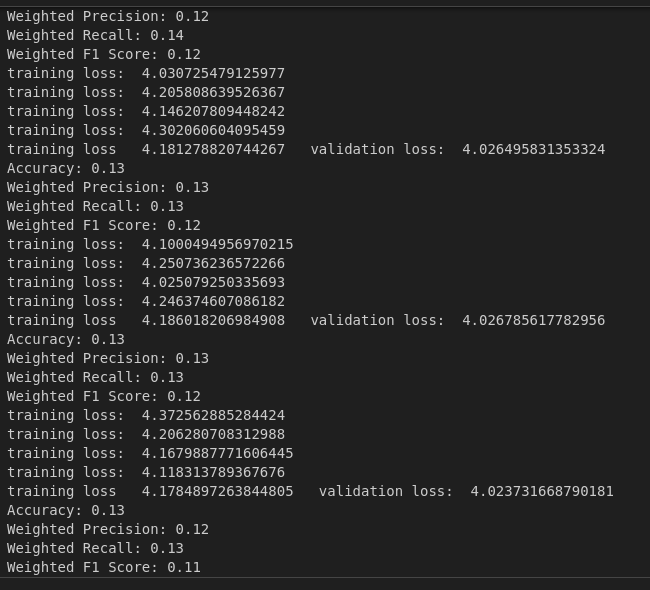

Macro Average

    Macro Average calculates the metric (precision, recall, F1 score) for each class independently and then takes the average. It treats all classes equally, regardless of how many instances belong to each class. This can be useful when you want to assess the performance across classes without being biased by class imbalance.
        Macro Precision: Average precision across all classes.
        Macro Recall: Average recall across all classes.
        Macro F1 Score: Average F1 score across all classes.

Weighted Average

    Weighted Average also calculates the metric for each class, but it takes into account the number of true instances (support) for each class when calculating the average. This means classes with more instances have a greater influence on the final score. This is useful when you want the overall performance to reflect the performance on larger classes more accurately.
        Weighted Precision: Weighted by the number of true instances in each class.
        Weighted Recall: Weighted by the number of true instances in each class.
        Weighted F1 Score: Weighted by the number of true instances in each class.

Support: The number of actual instances of each class in the dataset.

## QUNN 10 STARTED HERE RESNET MODEL TRAINED

Implement a classifier on the given data by fine-tuning a Resnet (32 or 50)
pre-trained on imagenet. Compute and report the classification accuracy
and the F1 score and compare it with the MLP trained before on the
decoded latents

{0: 'bee', 1: 'caterpillar', 2: 'rat', 3: 'ox', 4: 'hummingbird', 5: 'crab', 6: 'cockroach', 7: 'fox', 8: 'okapi', 9: 'cow', 10: 'hornbill', 11: 'donkey', 12: 'hare', 13: 'rhinoceros', 14: 'gorilla', 15: 'owl', 16: 'bat', 17: 'grasshopper', 18: 'hedgehog', 19: 'lion'}
tensor([18, 15, 19, 14,  8, 15,  8,  0, 12, 14,  4,  4,  5, 11, 10, 14,  4, 14,
         7,  7, 19,  2,  9,  5,  6, 17,  7,  3,  3,  4,  9, 14, 11, 19,  5, 15,
         6,  4,  3,  7, 10, 13,  0, 15, 16, 16, 12,  9,  0,  2,  4,  3,  4,  7,
         6, 10,  5, 15,  9, 12,  0,  7, 10,  7])


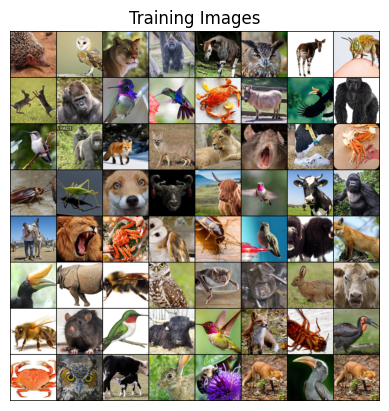

In [48]:
#10 fine tuned the resnet model for classification. 
# used pretrained resnet model and fine tuned it on animal dataset used resnet 50 model

num_classes = 20   
dataroot = "animals/"
dataset = CustomDataset_conditional_Gan(dataroot=dataroot, num_classes=num_classes,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader


# NEED TO SPLIT the data set into train , validation and test set
#  train size contains 80% of the data, validation contains 10% and test contains 10%

train_size = int(0.8 * len(dataset))
val_size = int(0.1 * len(dataset))
test_size = len(dataset) - train_size - val_size

 #split first 80% of the data for training, next 10% for validation and last 10% for testing
train_dataset, val_dataset, test_dataset = torch.utils.data.random_split(dataset, [train_size, val_size, test_size])



animal_dict = dataset.get_animal_dict()
print(animal_dict)
train_dataloader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True, drop_last=True)
val_dataloader = torch.utils.data.DataLoader(val_dataset, batch_size=batch_size, shuffle=True, drop_last=True)
test_dataloader = torch.utils.data.DataLoader(test_dataset, batch_size=batch_size, shuffle=True, drop_last=True)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available()) else "cpu")

# Plot some training images
real_batch = next(iter(train_dataloader))
print(real_batch[1])
# plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()


In [46]:
# resnet classifier model creation and parameter initialization

import torch.optim as optim
import torchvision.models as models
from sklearn.metrics import accuracy_score, f1_score

class CustomResNet(nn.Module):
    def __init__(self, num_classes):
        super(CustomResNet, self).__init__()
        self.resnet = models.resnet50(weights=models.ResNet50_Weights.DEFAULT)
        self.resnet.fc = nn.Linear(self.resnet.fc.in_features, num_classes)
 
    def forward(self, x):
        return self.resnet(x)
    

def evaluate_classifier(classifier, data_loader):
    classifier.eval()
    all_preds = []
    all_labels = []
    with torch.no_grad():
        for images, labels in data_loader:
            images = images.to(device)
            labels = labels.to(device)
            outputs = classifier(images)
            _, preds = torch.max(outputs, 1)
            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())
    accuracy = accuracy_score(all_labels, all_preds)
    f1 = f1_score(all_labels, all_preds, average='weighted')
    return accuracy, f1

In [49]:
#training the resnet model on classification task. 
model = CustomResNet(num_classes).to(device)
optimizer = optim.Adam(model.parameters(), lr=0.0001)
criterion = nn.CrossEntropyLoss()

num_epochs = 10
for epoch in range(num_epochs):
    model.train()
    for i, (images, labels) in enumerate(train_dataloader):
        images = images.to(device)
        labels = labels.to(device)
        outputs = model(images)
        loss = criterion(outputs, labels)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
    print(f'Epoch [{epoch + 1}/{num_epochs}], Loss: {loss.item()}')
 

resnet_accuracy, resnet_f1 = evaluate_classifier(model, test_dataloader)
print(f'ResNet Classifier - Accuracy: {resnet_accuracy}, F1 Score: {resnet_f1}')
 
torch.save(model.state_dict(), 'resnet_90_class_weights.pth')
print("Model weights saved to 'resnet_90_class_weights.pth'.")

Epoch [1/10], Loss: 2.374316930770874
Epoch [2/10], Loss: 1.208317756652832
Epoch [3/10], Loss: 0.4966656267642975
Epoch [4/10], Loss: 0.13879989087581635
Epoch [5/10], Loss: 0.03923990577459335
Epoch [6/10], Loss: 0.032076187431812286
Epoch [7/10], Loss: 0.018272753804922104
Epoch [8/10], Loss: 0.012387285009026527
Epoch [9/10], Loss: 0.007821864448487759
Epoch [10/10], Loss: 0.006968199275434017
ResNet Classifier - Accuracy: 0.96875, F1 Score: 0.9707532051282051
Model weights saved to 'resnet_90_class_weights.pth'.


as obviiopus resnet giving really good accuracy of 99%.
but out mlp also performing well giving accuracy 10 times better than the random guess.
as there are 90 classes the random prediction would be 1% and the model we trained we get accuracy of 13% and got f1 score of 0.11



## QUN 11 STARTED HERE
## TRAINED RESNET MODEL ON REAL IMAGES FOR 20 CLASSES

 Take the 20-class subset of the data (as taken in problem (6)), train a
resnet-based classifier, and report the metrics

{0: 'bee', 1: 'caterpillar', 2: 'rat', 3: 'ox', 4: 'hummingbird', 5: 'crab', 6: 'cockroach', 7: 'fox', 8: 'okapi', 9: 'cow', 10: 'hornbill', 11: 'donkey', 12: 'hare', 13: 'rhinoceros', 14: 'gorilla', 15: 'owl', 16: 'bat', 17: 'grasshopper', 18: 'hedgehog', 19: 'lion'}
tensor([ 6,  7,  4,  2,  0,  3,  3,  0,  4, 16,  6,  9, 14,  5,  7, 17, 15,  8,
        10, 14,  3,  1, 13,  2, 13,  8, 10,  8, 17, 17,  8, 11,  9, 14,  5, 11,
        19, 12, 19,  5, 17,  3,  0, 11, 19, 15, 12, 12,  9, 11, 11,  8,  7,  9,
        14,  3,  6, 12, 11, 14,  3, 10,  3,  4])


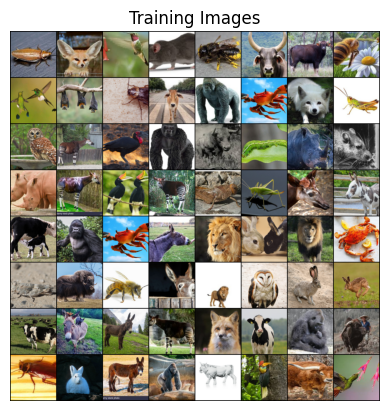

In [40]:
# qun 11 training only on the 20 classes.
num_classes = 20   
dataroot = "animals/"
dataset = CustomDataset_conditional_Gan(dataroot=dataroot, num_classes=num_classes,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader


# NEED TO SPLIT the data set into train , validation and test set
#  train size contains 80% of the data, validation contains 10% and test contains 10%

train_size = int(0.8 * len(dataset))
val_size = int(0.1 * len(dataset))
test_size = len(dataset) - train_size - val_size

 #split first 80% of the data for training, next 10% for validation and last 10% for testing
train_dataset, val_dataset, test_dataset = torch.utils.data.random_split(dataset, [train_size, val_size, test_size])



animal_dict = dataset.get_animal_dict()
print(animal_dict)
train_dataloader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True, drop_last=True)
val_dataloader = torch.utils.data.DataLoader(val_dataset, batch_size=batch_size, shuffle=True, drop_last=True)
test_dataloader = torch.utils.data.DataLoader(test_dataset, batch_size=batch_size, shuffle=True, drop_last=True)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available()) else "cpu")

# Plot some training images
real_batch = next(iter(train_dataloader))
print(real_batch[1])
# plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()


In [41]:
#training the resnet model on classification for 20 classes and printing the accuracy and f1 score
model_20classes = CustomResNet(num_classes).to(device)
 
optimizer = optim.Adam(model_20classes.parameters(), lr=0.0001)
criterion = nn.CrossEntropyLoss()

num_epochs = 10
for epoch in range(num_epochs):
    model_20classes.train()
    for i, (images, labels) in enumerate(train_dataloader):
        images = images.to(device)
        labels = labels.to(device)
        outputs = model_20classes(images)
        loss = criterion(outputs, labels)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
    print(f'Epoch [{epoch + 1}/{num_epochs}], Loss: {loss.item()}')


resnet_accuracy, resnet_f1 = evaluate_classifier(model_20classes , test_dataloader)
print(f'ResNet Classifier - Accuracy: {resnet_accuracy}, F1 Score: {resnet_f1}')
 
torch.save(model_20classes.state_dict(), 'resnet_20class_weights.pth')
print("Model weights saved to 'resnet_20class_weights.pth'.")

Epoch [1/10], Loss: 2.375462770462036
Epoch [2/10], Loss: 1.2244905233383179
Epoch [3/10], Loss: 0.4717307388782501
Epoch [4/10], Loss: 0.14397646486759186
Epoch [5/10], Loss: 0.03782348334789276
Epoch [6/10], Loss: 0.040510378777980804
Epoch [7/10], Loss: 0.018802456557750702
Epoch [8/10], Loss: 0.011959784664213657
Epoch [9/10], Loss: 0.016042698174715042
Epoch [10/10], Loss: 0.01037881150841713
ResNet Classifier - Accuracy: 0.96875, F1 Score: 0.9624065170940171
Model weights saved to 'resnet_20class_weights.pth'.


trained to real data

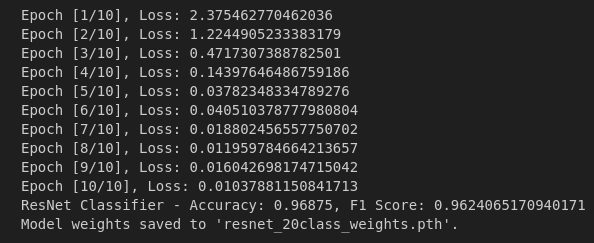

## QUN 12
## GENERATED IMAGES USING CONDITIONAL GAN AND THE TRAINED THE RESNET MODEL FOR CLASSIFICATION ON REAL DATA

Use the c-GAN trained in problem (6) to generate 100 more images per
each of the 20-classes. Use these augmented data to retrain the classifier
in the previous question. Compare the results with the previous classifier
without augmentation.

In [ ]:
# first we generate the images using the conditional gan model

dcgan_animal_trained = Generator_dcgan().to(device)
dcgan_animal_trained.load_state_dict(torch.load('final/dcgan_gen_animal.pth'))


import os
import torch
from torchvision.utils import save_image

num_classes = 20  
embed_size = 100  

os.makedirs("generated_images", exist_ok=True)


for class_num in range(num_classes):
    class_name = animal_dict[class_num]  
    class_folder = os.path.join("generated_images", class_name)
    os.makedirs(class_folder, exist_ok=True) 

    for i in range(100):  
        noise = torch.randn(1,  nz, 1, 1, device=device) 

        class_label = torch.tensor([class_num], device=device)  

        with torch.no_grad():
            fake_image = dcgan_animal_trained(noise, class_label).detach().cpu()  
            fake_image = (fake_image + 1) / 2

        save_image(fake_image, os.path.join(class_folder, f"{class_name}_{i}.png"))

print("Image generation complete!")

{0: 'bee', 1: 'caterpillar', 2: 'rat', 3: 'ox', 4: 'hummingbird', 5: 'crab', 6: 'cockroach', 7: 'fox', 8: 'okapi', 9: 'cow', 10: 'hornbill', 11: 'donkey', 12: 'hare', 13: 'rhinoceros', 14: 'gorilla', 15: 'owl', 16: 'bat', 17: 'grasshopper', 18: 'hedgehog', 19: 'lion'}
tensor([ 5,  8, 17, 16,  3,  4, 14,  6, 13,  8, 11,  2,  5,  2, 15,  2,  4, 14,
         3, 12, 12,  9, 13,  2, 18,  2, 12,  9, 19, 18,  7, 10, 18, 13, 18,  1,
         0, 11,  4,  0,  9,  4,  1, 11,  1,  6, 19,  8, 16, 18, 10, 18,  9, 19,
         9, 11, 12, 12, 17,  1, 13, 14,  2,  1])


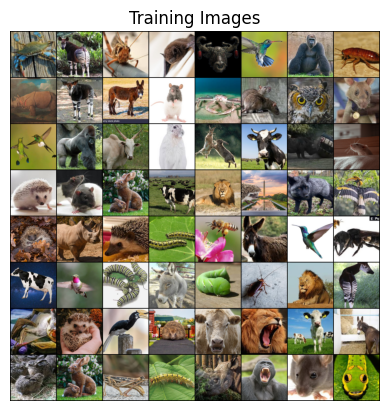

In [42]:
#now we load the above images and train the resnet model on these images

dataroot = "generated_images/"
num_classes = 20

dataset_genimges = CustomDataset_conditional_Gan(dataroot=dataroot,num_classes=num_classes,
                                                transform=transforms.Compose([
                                            transforms.Resize(image_size),
                                            transforms.ToTensor(),
                                            transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                                        ]))

#reate the dataloader train test and validation set

train_size = int(0.8 * len(dataset_genimges))
val_size = int(0.1 * len(dataset_genimges))
test_size = len(dataset_genimges) - train_size - val_size

# split first 80% of the data for training, next 10% for validation and last 10% for testing
train_dataset, val_dataset, test_dataset = torch.utils.data.random_split(dataset_genimges, [train_size, val_size, test_size])



animal_dict = dataset_genimges.get_animal_dict()
print(animal_dict)
train_dataloader_gen = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True, drop_last=True)
val_dataloader_gen = torch.utils.data.DataLoader(val_dataset, batch_size=batch_size, shuffle=True, drop_last=True)
test_dataloader_gen = torch.utils.data.DataLoader(test_dataset, batch_size=batch_size, shuffle=True, drop_last=True)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available()) else "cpu")

# Plot some training images
real_batch = next(iter(train_dataloader))

print(real_batch[1])
# plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()


In [44]:
#training the resnet model on classification for 20 classes and printing the accuracy and f1 score
model_20_genim = CustomResNet(num_classes).to(device)
 
optimizer = optim.Adam(model_20_genim.parameters(), lr=0.0001)
criterion = nn.CrossEntropyLoss()

num_epochs = 10
for epoch in range(num_epochs):
    model_20_genim.train()
    for i, (images, labels) in enumerate(train_dataloader_gen):
        images = images.to(device)
        labels = labels.to(device)
        outputs = model_20_genim(images)
        loss = criterion(outputs, labels)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
    print(f'Epoch [{epoch + 1}/{num_epochs}], Loss: {loss.item()}')


resnet_accuracy, resnet_f1 = evaluate_classifier(model_20_genim , test_dataloader_gen)
print(f'ResNet Classifier - Accuracy: {resnet_accuracy}, F1 Score: {resnet_f1}')
 
torch.save(model_20_genim.state_dict(), 'resnet_20_class_gen_images_weights.pth')
print("Model weights saved to 'resnet_20class_weights.pth'.")

Epoch [1/10], Loss: 2.3333351612091064
Epoch [2/10], Loss: 1.3912029266357422
Epoch [3/10], Loss: 0.7259572744369507
Epoch [4/10], Loss: 0.169575497508049
Epoch [5/10], Loss: 0.03580084070563316
Epoch [6/10], Loss: 0.014346878975629807
Epoch [7/10], Loss: 0.007510919123888016
Epoch [8/10], Loss: 0.005588708911091089
Epoch [9/10], Loss: 0.007440609857439995
Epoch [10/10], Loss: 0.0027014692313969135
ResNet Classifier - Accuracy: 0.90625, F1 Score: 0.9090283044487008
Model weights saved to 'resnet_20class_weights.pth'.


training of resnet on the image generated from conditional gan model.

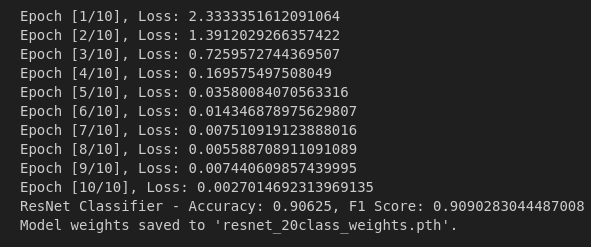

In [55]:
#print accuracy on real data
resnet_accuracy, resnet_f1 = evaluate_classifier(model_20_genim , test_dataloader)
print(f'ResNet Classifier - Accuracy: {resnet_accuracy}, F1 Score: {resnet_f1}')

ResNet Classifier - Accuracy: 0.046875, F1 Score: 0.020833333333333332


ResNet Classifier - Accuracy: 0.046875, F1 Score: 0.020833333333333332
